In [3]:
from __future__ import print_function
from matplotlib import pyplot as plt
plt.switch_backend('agg')
%matplotlib inline
import numpy as np

from IPython.display import display, HTML
import h5py


In [4]:
def Overlap_calc(hp,sp,psd):
    f_low = 18
    m, i = match(hp, sp, psd=psd, low_frequency_cutoff=f_low)
    o = overlap(hp, sp, psd=psd, low_frequency_cutoff=f_low)
    return m


In [7]:
from scipy.fft import fft, ifft

def get_snr_frac(decoded_signal, pure_signal, signal_type):
    
    if(signal_type == 'injection'):
    
        h_fft = fft(pure_signal)
        template_fft = fft(pure_signal)
        snr_freq = (h_fft * template_fft.conjugate())
        snr_time = np.abs(ifft(snr_freq))
        optimal_snr_ligo = np.sqrt(np.max(snr_time))
    
        h_fft = fft(decoded_signal)
        template_fft = fft(decoded_signal)
        snr_freq = (h_fft * template_fft.conjugate())
        snr_time = np.abs(ifft(snr_freq))
        optimal_snr_ml = np.sqrt(np.max(snr_time))

        return optimal_snr_ml/optimal_snr_ligo
    
    elif(signal_type == 'pure_noise'):
        
        h_fft = fft(decoded_signal)
        template_fft = fft(decoded_signal)
        snr_freq = (h_fft * template_fft.conjugate())
        snr_time = np.abs(ifft(snr_freq))
        optimal_snr_ml = np.sqrt(np.max(snr_time))
        
        return optimal_snr_ml


In [8]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries
import matplotlib.pyplot as plt
import matplotlib_latex_bridge as mlb

mlb.setup_page(**mlb.formats.article_letterpaper_10pt_singlecolumn)


def plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr, spin1a, spin2a, spin1_azimuthal, spin1_polar, spin2_azimuthal, spin2_polar, signal_type):
    
    time_buffer = 4
    length_signal = len(decoded_signals)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    
    X_test_pure_ts = TimeSeries(pure_signals.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signals.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

 #   if(X_test_pure_ts.max() != 0.0):
 #       m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
 #       signal_type = 'injection'
 #   else:
 #       m = 1
 #       signal_type = 'pure_noise'
    
 #   snr_opt = get_snr_frac(decoded_signals.squeeze(), pure_signals, signal_type=signal_type)

    if(signal_type == 'injection'):

        m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
        
        fig = plt.figure(figsize=(10,5))

        time = np.linspace(0.0, 1.0, length_signal)

        plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.4)

        signal_axes = fig.add_subplot(211)
#       signal_axes.set_ylim(-1.1, 1.1)
        signal_axes.set_title('${{m_{{1}}}}$ = {m1}, ${{m_{{2}}}}$ = {m2}, ${{\chi_{{1}}}}$ = {spin1a}, ${{\chi_{{2}}}}$ = {spin2a}, ${{\\theta_{{1}}}}$ = {spin1_polar}, ${{\phi_{{1}}}}$ = {spin1_azimuthal}, ${{\\theta_{{2}}}}$ = {spin2_polar}, ${{\phi_{{2}}}}$ = {spin2_azimuthal}, $\mathcal O$ = {m}'.format(m1=np.round(m1,2), m2=np.round(m2,2), spin1a=np.round(spin1a,2), spin2a=np.round(spin2a,2), spin1_polar=np.round(spin1_polar,2), spin1_azimuthal=np.round(spin1_azimuthal,2), spin2_polar=np.round(spin2_polar,2), spin2_azimuthal=np.round(spin2_azimuthal,2), m=np.round(m,2)))
        signal_axes.plot(time,strain.squeeze()/0.02, linewidth=1.2, label ='Whitened strain', alpha=0.5)
        signal_axes.plot(time,pure_signals.squeeze(), linewidth=1.2, label ='Whitened waveform', c='green')
        signal_axes.plot(time,decoded_signals.squeeze(), linewidth=1.2, label ='Reconstructed waveform', c='red', linestyle='dashed')
    
        signal_axes.set_ylabel('Rescaled amplitudes', fontsize=14)
        signal_axes.set_xlabel('Time (in secs)', fontsize=14)
        signal_axes.tick_params(axis='x', labelsize=14)
        signal_axes.tick_params(axis='y', labelsize=14)
        signal_axes.legend(fontsize=14)


    elif(signal_type == 'noise'):

        fig = plt.figure(figsize=(10,5))

        time = np.linspace(0.0, 1.0, length_signal)

        plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.4)

        signal_axes = fig.add_subplot(211)
#       signal_axes.set_ylim(-1.1, 1.1)
#        signal_axes.set_title('${{m_{{1}}}}$ = {m1}, ${{m_{{2}}}}$ = {m2}, ${{\chi_{{1}}}}$ = {spin1a}, ${{\chi_{{2}}}}$ = {spin2a}, ${{\\theta_{{1}}}}$ = {spin1_polar}, ${{\phi_{{1}}}}$ = {spin1_azimuthal}, ${{\\theta_{{2}}}}$ = {spin2_polar}, ${{\phi_{{2}}}}$ = {spin2_azimuthal}, SNR = {snr}, Overlap = {m}'.format(m1=np.round(m1,2), m2=np.round(m2,2), spin1a=np.round(spin1a,2), spin2a=np.round(spin2a,2), spin1_polar=np.round(spin1_polar,2), spin1_azimuthal=np.round(spin1_azimuthal,2), spin2_polar=np.round(spin2_polar,2), spin2_azimuthal=np.round(spin2_azimuthal,2), snr=np.round(snr,2), m=np.round(m,2)))
        signal_axes.plot(time,strain.squeeze()/0.02, linewidth=1.2, label ='Whitened strain', alpha=0.5)
#        signal_axes.plot(time,pure_signals.squeeze(), linewidth=1.2, label ='Whitened waveform', c='green')
        signal_axes.plot(time,decoded_signals.squeeze(), linewidth=1.2, label ='Reconstructed waveform', c='red', linestyle='dashed')
    
        signal_axes.set_ylabel('Rescaled amplitudes', fontsize=14)
        signal_axes.set_xlabel('Time (in secs)', fontsize=14)
        signal_axes.tick_params(axis='x', labelsize=14)
        signal_axes.tick_params(axis='y', labelsize=14)
        signal_axes.legend(fontsize=14)

    plt.savefig('IMBH_test/IMRPhenomXPHM_O3b_signal+noise/Chirp_mass_test/Mchirp_10to20/SNR-20to30/Weighted_loss_Plot_m1-'+str(int(m1))+'_m2-'+str(int(m2))+'_snr-'+str(int(snr))+'.png', bbox_inches='tight', facecolor='w', transparent=False, dpi=400)
#    plt.savefig('IMBH_test/IMRPhenomXPHM_O3b_signal+noise/Chirp_mass_test/Test_SNR/Weighted_loss_Plot_m1-'+str(int(m1))+'_m2-'+str(int(m2))+'_snr-'+str(int(snr))+'.png', bbox_inches='tight', facecolor='w', transparent=False, dpi=200)
   

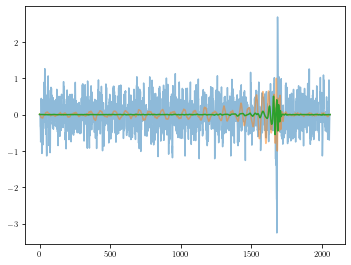

In [5]:
f1 = h5py.File('/fred/oz016/Chayan/GW-Denoiser/evaluation/results_IMBH_IMRPhenomXPHM_10_timesteps_O3b_signal_noise_SNR-all_mchirp_10-20_weighted_loss.hdf', 'r')
f2 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_SNR-8to10_max_mchip_10.hdf", "r")

strain = np.pad(f2['injection_samples']['l1_strain'][14].astype(np.float64), (5,5), constant_values=(0,0))

decoded_signals = f1['denoised_signals'][14].astype(np.float64)
pure_signals = f1['pure_signals'][14].astype(np.float64)

plt.plot(strain/0.05, alpha=0.5)
plt.plot(pure_signals, alpha=0.5)
plt.plot(decoded_signals)


# SNR - 8 to 10

<ipython-input-4-6fea9369639c>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


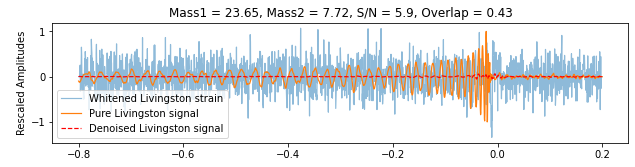

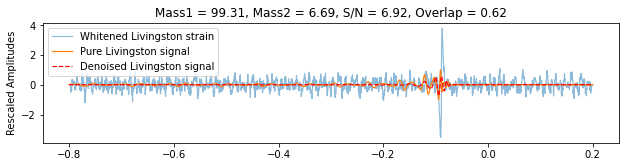

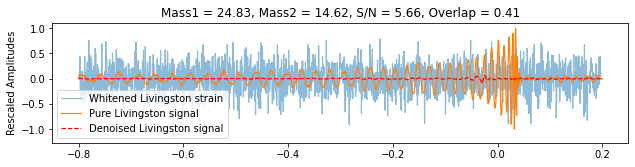

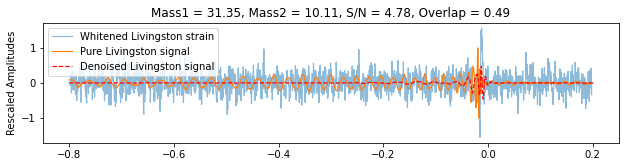

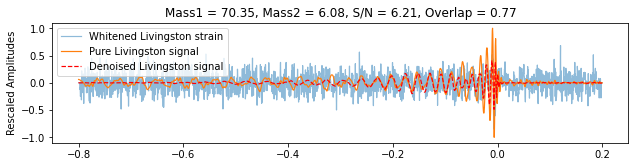

...

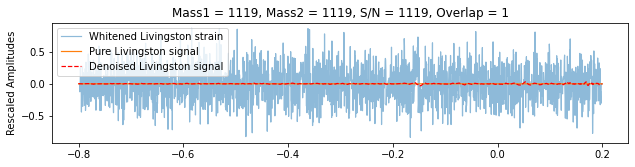

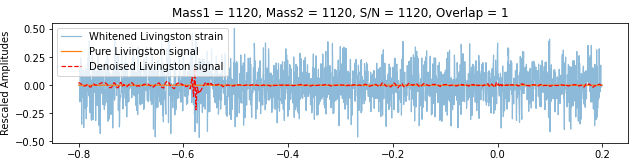

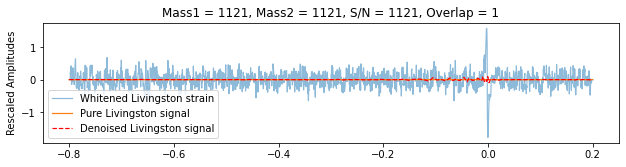

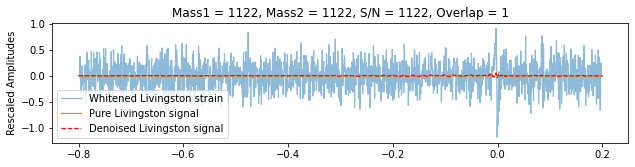

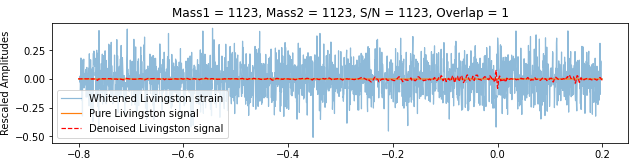

In [5]:
f1 = h5py.File('/fred/oz016/Chayan/GW-Denoiser/evaluation/results_IMBH_IMRPhenomXPHM_10_timesteps_O3b_signal_noise_SNR-all_mchirp_10-20_weighted_loss.hdf', 'r')
f2 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_SNR-8to10_max_mchip_10.hdf", "r")

noise_index = range(100,125)
signal_index = range(25)
j = -1
   
for i in range(25):
    decoded_signals = f1['denoised_signals'][i].astype(np.float64)
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    
    strain = np.pad(f2['injection_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f2['injection_parameters']['mass1'][i]
    m2 = f2['injection_parameters']['mass2'][i]
    snr = f2['injection_parameters']['l1_snr'][j]*f2['injection_parameters']['scale_factor'][j]
    
    plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr)

j = -1

for i in range(100,125):
    
    decoded_signals = f1['denoised_signals'][i].astype(np.float64)
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    strain = np.pad(f2['noise_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr)
    

# SNR - 10 to 20

<ipython-input-25-f28593914f13>:44: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.1,
<ipython-input-25-f28593914f13>:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(10,5))


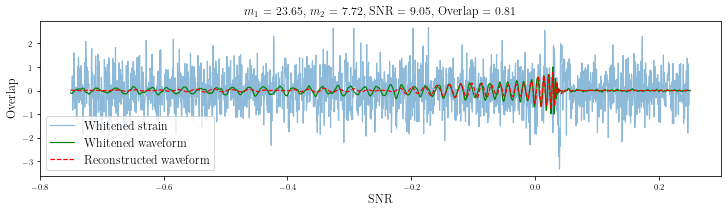

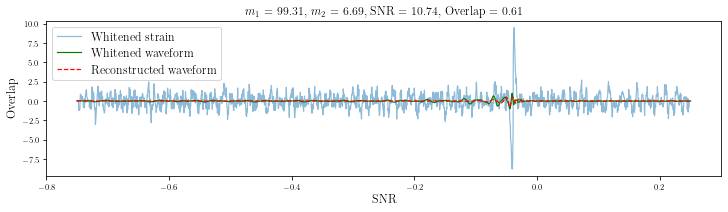

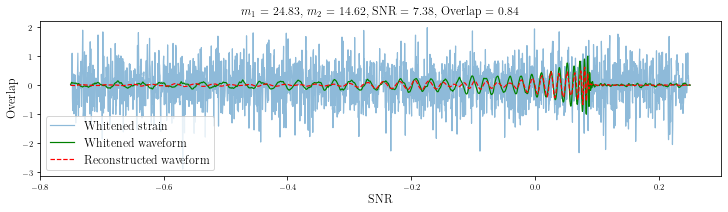

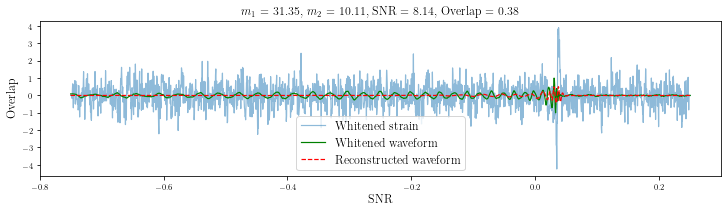

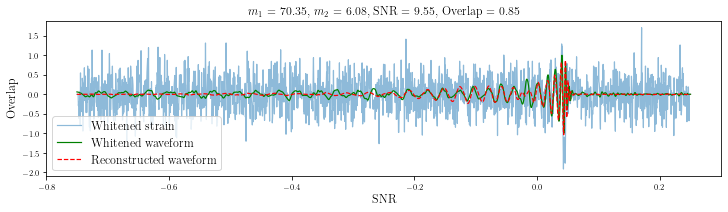

...

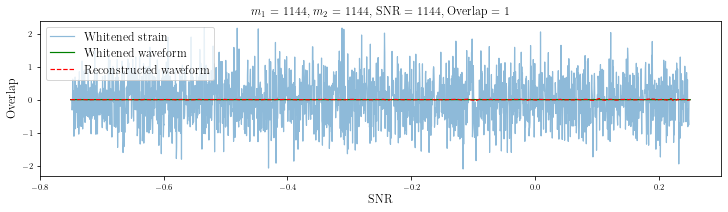

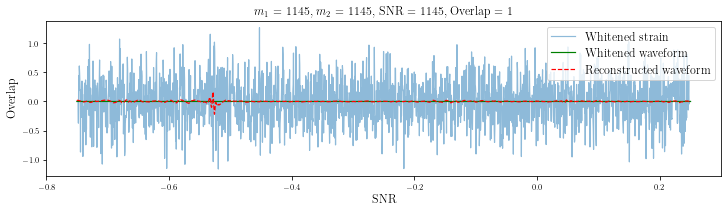

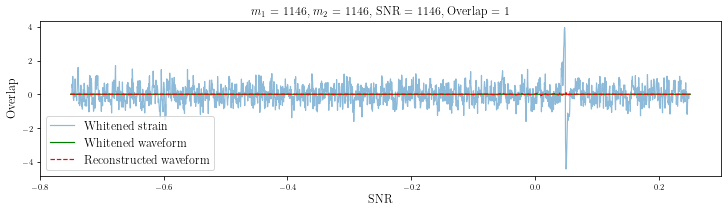

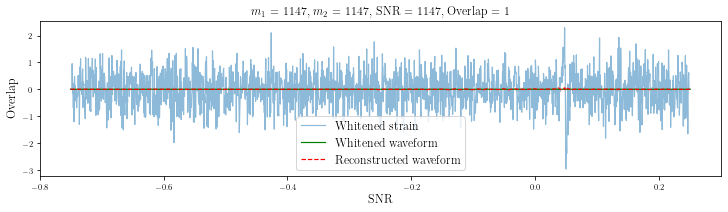

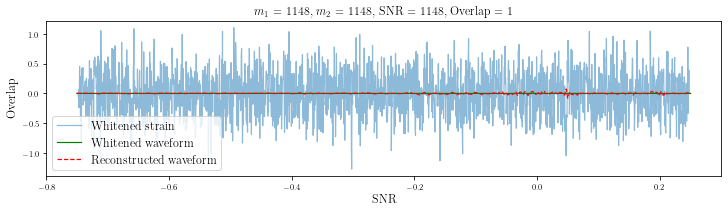

In [26]:
f1 = h5py.File('/fred/oz016/Chayan/GW-Denoiser/evaluation/results_IMBH_IMRPhenomXPHM_10_timesteps_O3b_signal_noise_SNR-all_mchirp_10-20_weighted_loss.hdf', 'r')
f2 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_SNR-10to20_max_mchip_10.hdf", "r")

noise_index = range(100,125)
signal_index = range(25)
j = -1
   
for i in range(25,50):
    decoded_signals = f1['denoised_signals'][i].astype(np.float64)
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    
    strain = np.pad(f2['injection_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f2['injection_parameters']['mass1'][j]
    m2 = f2['injection_parameters']['mass2'][j]
    snr = f2['injection_parameters']['l1_snr'][j]*f2['injection_parameters']['scale_factor'][j]
    
    plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr)

j = -1

for i in range(125,150):
    
    decoded_signals = f1['denoised_signals'][i].astype(np.float64)
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    strain = np.pad(f2['noise_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr)
    

# SNR - 20 to 30

In [ ]:
f2['injection_parameters']['spin2_a'][()]

<ipython-input-8-f00a147345e6>:48: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.1,
<ipython-input-8-f00a147345e6>:48: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.1,
<ipython-input-8-f00a147345e6>:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(10,5))
<ipython-input-8-f00a147345e6>:75: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adju

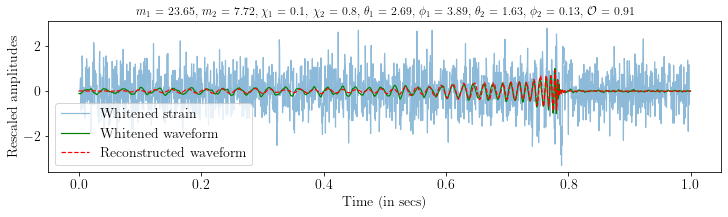

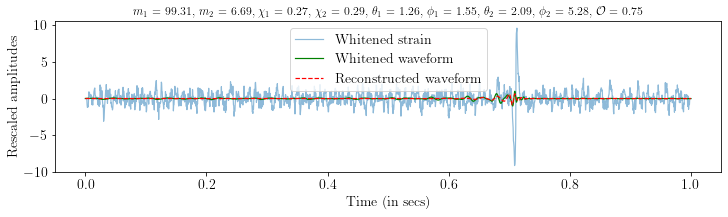

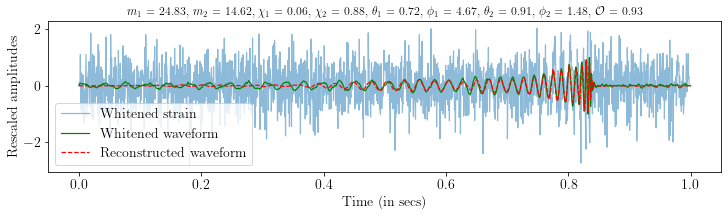

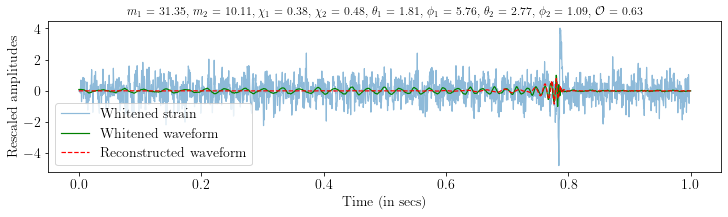

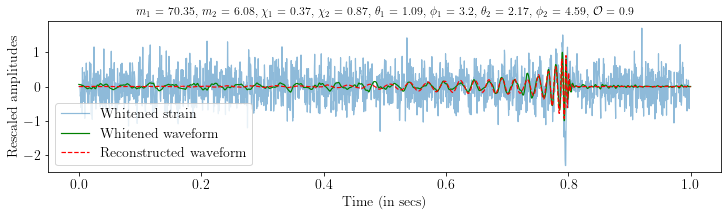

...

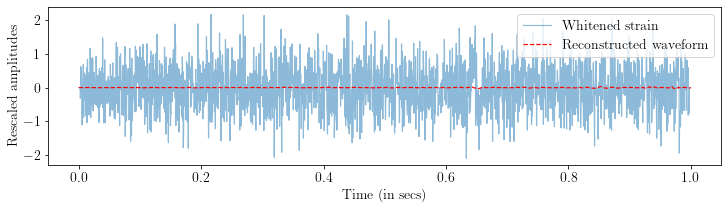

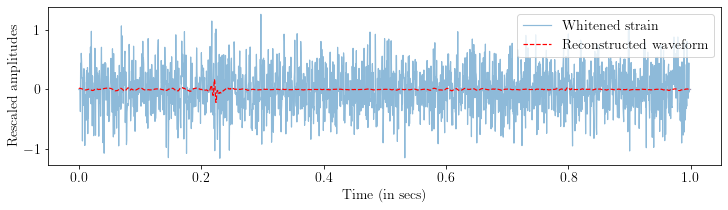

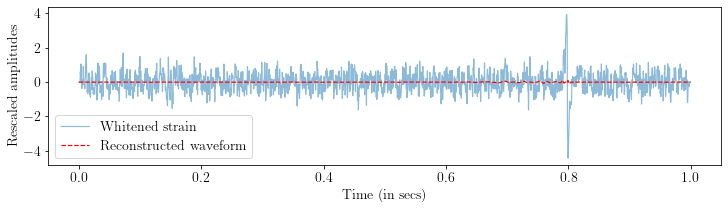

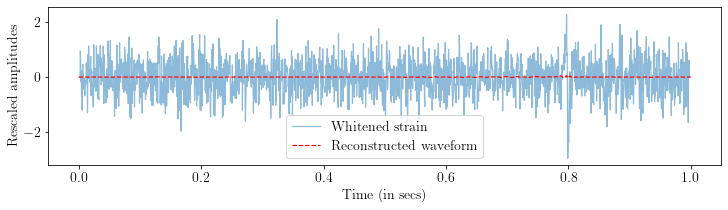

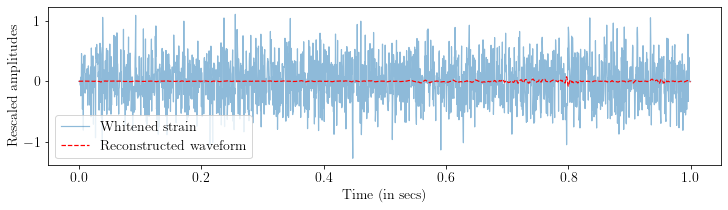

In [9]:
f1 = h5py.File('/fred/oz016/Chayan/GW-Denoiser/evaluation/results_IMBH_IMRPhenomXPHM_10_timesteps_O3b_signal_noise_SNR-all_mchirp_10-20_weighted_loss.hdf', 'r')
f2 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_SNR-20to30_max_mchip_10.hdf", "r")

noise_index = range(100,125)
signal_index = range(25)
j = -1
   
for i in range(50,75):
    decoded_signals = f1['denoised_signals'][i].astype(np.float64)
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    
    strain = np.pad(f2['injection_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f2['injection_parameters']['mass1'][j]
    m2 = f2['injection_parameters']['mass2'][j]
    snr = f2['injection_parameters']['l1_snr'][j]*f2['injection_parameters']['scale_factor'][j]
    spin1a = f2['injection_parameters']['spin1_a'][j]
    spin2a = f2['injection_parameters']['spin2_a'][j]
    spin1_azimuthal = f2['injection_parameters']['spin1_azimuthal'][j]
    spin1_polar = f2['injection_parameters']['spin1_polar'][j]
    spin2_azimuthal = f2['injection_parameters']['spin2_azimuthal'][j]
    spin2_polar = f2['injection_parameters']['spin2_polar'][j]
    
    plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr, spin1a, spin2a, spin1_azimuthal, spin1_polar, spin2_azimuthal, spin2_polar, 'injection')

j = -1

for i in range(150,175):
    
    decoded_signals = f1['denoised_signals'][i].astype(np.float64)
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    strain = np.pad(f2['noise_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr, spin1a, spin2a, spin1_azimuthal, spin1_polar, spin2_azimuthal, spin2_polar, 'noise')
    

# SNR - 30 to 40

<ipython-input-20-727c3d9d679f>:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


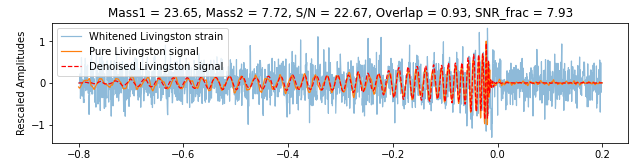

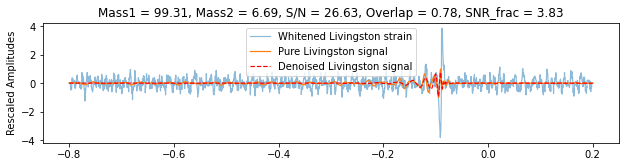

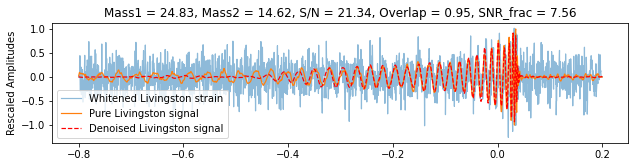

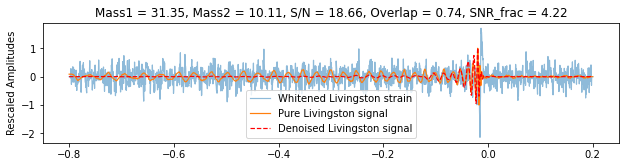

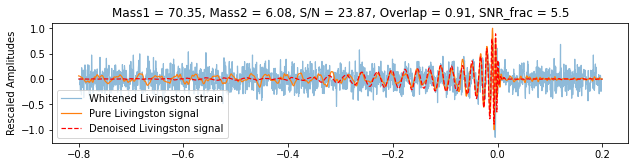

...

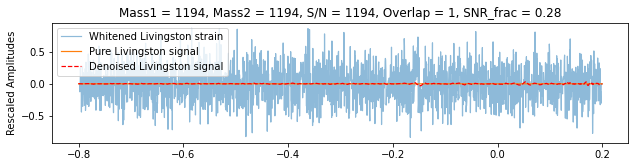

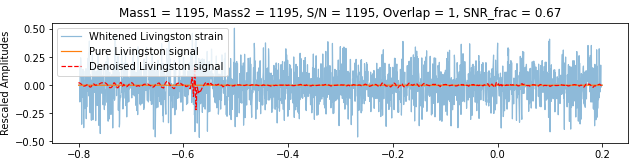

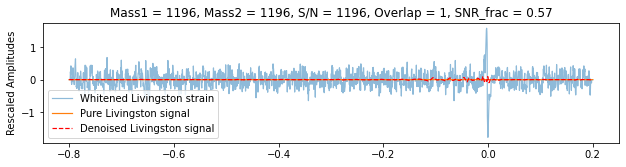

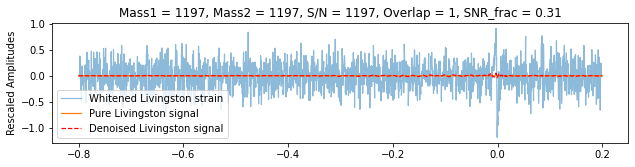

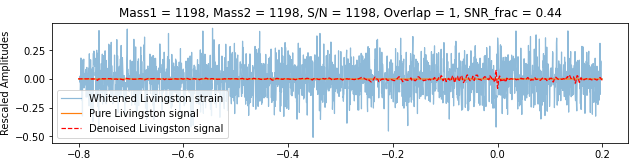

In [21]:
f1 = h5py.File('/fred/oz016/Chayan/GW-Denoiser/evaluation/results_IMBH_IMRPhenomXPHM_10_timesteps_O3b_signal_noise_SNR-all_mchirp_10-20_weighted_loss.hdf', 'r')
f2 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_SNR-30to40_max_mchip_10.hdf", "r")

noise_index = range(100,125)
signal_index = range(25)
j = -1
   
for i in range(75,100):
    decoded_signals = f1['denoised_signals'][i].astype(np.float64)
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    
    strain = np.pad(f2['injection_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f2['injection_parameters']['mass1'][j]
    m2 = f2['injection_parameters']['mass2'][j]
    snr = f2['injection_parameters']['l1_snr'][j]*f2['injection_parameters']['scale_factor'][j]
    
    plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr)

j = -1

for i in range(175,200):
    
    decoded_signals = f1['denoised_signals'][i].astype(np.float64)
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    strain = np.pad(f2['noise_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr)
    

In [6]:
from __future__ import print_function
from matplotlib import pyplot as plt
plt.switch_backend('agg')
%matplotlib inline
import numpy as np
#import pandas as pd

from IPython.display import display, HTML
import tensorflow as tf
#import numpy as np
#import pandas as pd
#import random as ran
import h5py


In [7]:
f1 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_SNR-30to40_max_mchip_10.hdf", "r")
strain = f1['injection_samples']['l1_strain'][()]


In [8]:
def _preprocess_data(data, num, samples):
    new_array = []
    for i in range(num):
        dataset = data[i]
        if((dataset.max() != 0.0) and (dataset.min() != 0.0)):
            maximum = np.max(dataset)
            minimum = np.abs(np.min(dataset))
            for j in range(samples):
                if(dataset[j] > 0):
                    dataset[j] = dataset[j]/maximum
                else:
                    dataset[j] = dataset[j]/minimum
        new_array.append(dataset)
    return new_array, maximum, minimum


In [9]:
strain, maximum, minimum = _preprocess_data(strain, 25, 2048)

strain = np.array(strain)

strain.shape


(25, 2048)

In [10]:
# Split a univariate sequence into samples
#def split_sequence(sequence_noisy,sequence_pure,n_steps):
def split_sequence(sequence_noisy,n_steps):
    X = [] 
#    y = []
    for i in range(len(sequence_noisy)):
    # find the end of this pattern
        end_ix = i + n_steps
        # check if we are beyond the sequence
        if end_ix > len(sequence_noisy)-1:
            break
        # gather input and output parts of the pattern
        seq_x = sequence_noisy[i:end_ix] 
#        seq_y = sequence_pure[end_ix]
        X.append(seq_x)
#        y.append(seq_y)
#    return array(X), array(y)
    return np.array(X)
    
    
#def reshape_sequences(self, num, data_noisy, data_pure):
def reshape_sequences(num, data_noisy):
    n_steps = 10
    arr_noisy = []
#    arr_pure = []
        
    for i in range(num):
        X_noisy = data_noisy[i]
#        X_pure = data_pure[i]
        X_noisy = np.pad(X_noisy, (n_steps, n_steps), 'constant', constant_values=(0, 0))
#        X_pure = np.pad(X_pure, (n_steps, n_steps), 'constant', constant_values=(0, 0))
        # split into samples
#        X, y = self.split_sequence(X_noisy, X_pure, n_steps)
        X = split_sequence(X_noisy, n_steps)
        arr_noisy.append(X)
#        arr_pure.append(y)
    
    arr_noisy = np.asarray(arr_noisy)
#    arr_pure = np.asarray(arr_pure)
        
#    return arr_noisy, arr_pure
    return arr_noisy

X_test_noisy = reshape_sequences(25, strain)


In [11]:
# Reshape arrays to fit into Keras model
X_test_noisy = X_test_noisy[:,:,:,None]
        
print('x_test_noisy shape:', X_test_noisy.shape)

X_test_noisy = X_test_noisy.astype("float32")


x_test_noisy shape: (25, 2058, 10, 1)


In [12]:
#from keras.models import load_model
 
# load model
model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/trained_model_test_IMBH_HM_O3b_noise_mass_corrected.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})
# summarize model.
model.summary()


NameError: name 'FractalTanimotoLoss' is not defined

In [117]:
decoded_signals = model.predict(X_test_noisy, batch_size=25)


# SNR - 8 to 10

<ipython-input-17-575a942e1860>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


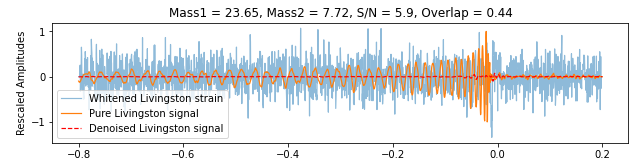

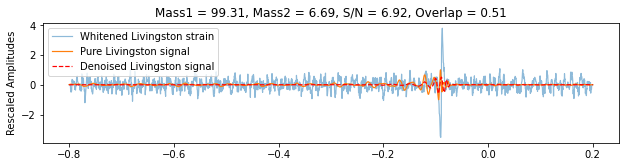

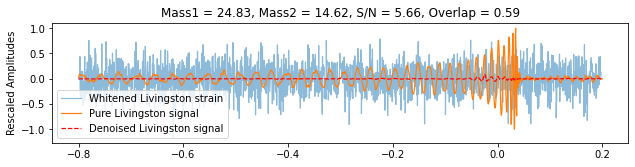

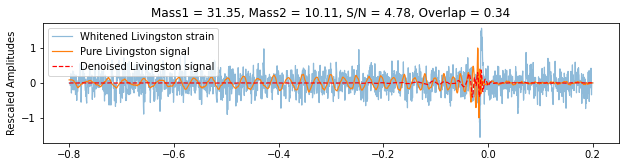

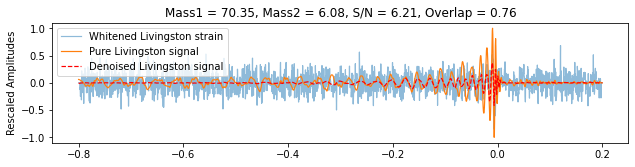

...

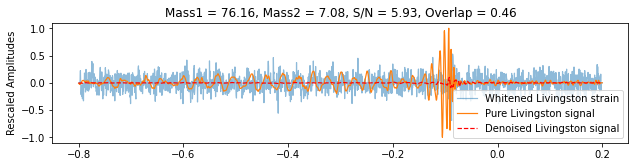

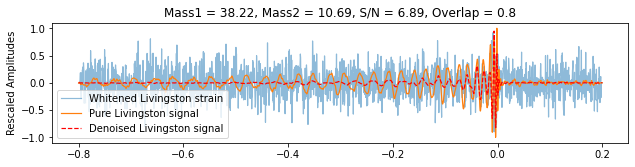

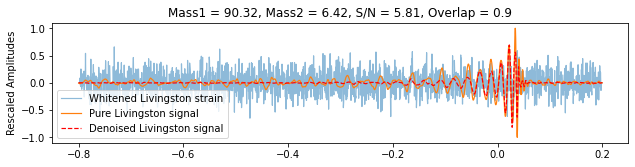

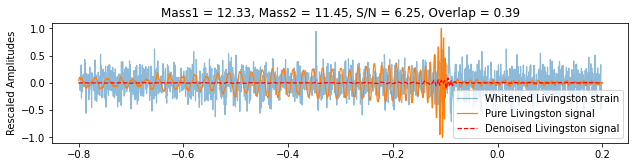

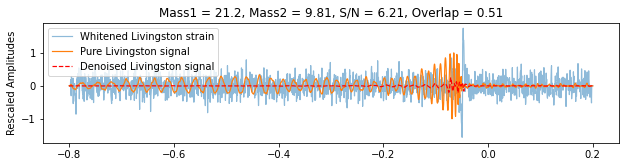

In [72]:
f1 = h5py.File('/fred/oz016/Chayan/GW-Denoiser/evaluation/results_IMBH_IMRPhenomXPHM_10_timesteps_O3b_signal_noise_SNR-all_max_mchirp_10.hdf', 'r')
f2 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_SNR-8to10_max_mchip_10.hdf", "r")

noise_index = range(100,125)
signal_index = range(25)
j = -1
   
for i in range(25):
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    
    strain = np.pad(f2['injection_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f2['injection_parameters']['mass1'][i]
    m2 = f2['injection_parameters']['mass2'][i]
    snr = f2['injection_parameters']['l1_snr'][j]*f2['injection_parameters']['scale_factor'][j]
    
    plot_reconstructed(decoded_signals[i].astype(np.float64), pure_signals, strain, m1, m2, snr)


# SNR - 10 to 20

<ipython-input-17-575a942e1860>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


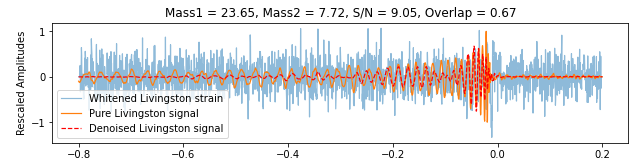

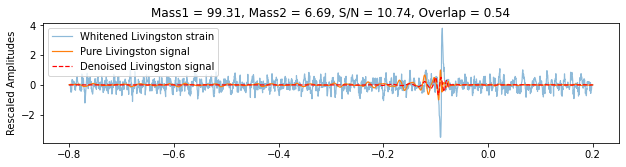

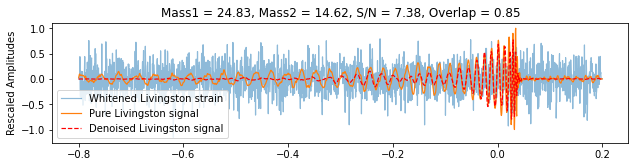

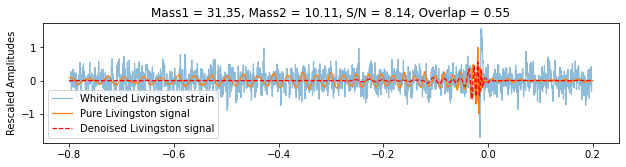

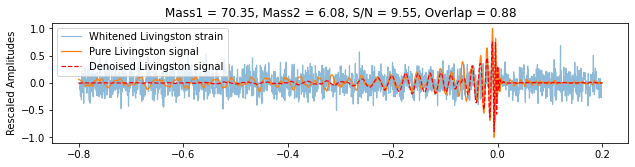

...

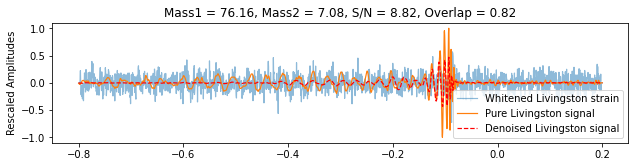

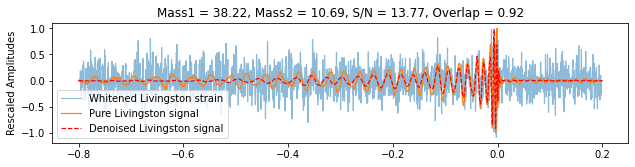

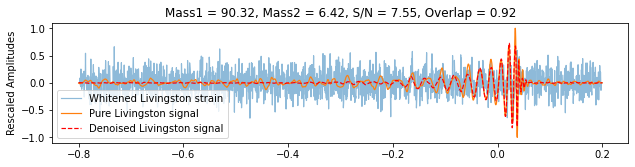

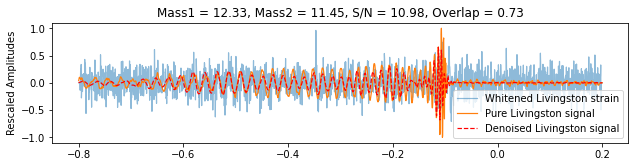

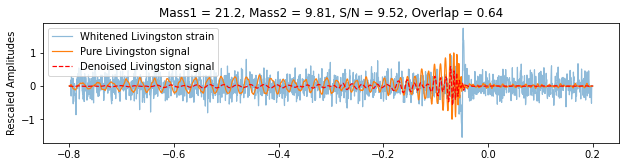

In [92]:
f1 = h5py.File('/fred/oz016/Chayan/GW-Denoiser/evaluation/results_IMBH_IMRPhenomXPHM_10_timesteps_O3b_signal_noise_SNR-all_max_mchirp_10.hdf', 'r')
f2 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_SNR-10to20_max_mchip_10.hdf", "r")

noise_index = range(100,125)
signal_index = range(25)
j = -1
   
for i in range(25,50):
    
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    
    strain = np.pad(f2['injection_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f2['injection_parameters']['mass1'][j]
    m2 = f2['injection_parameters']['mass2'][j]
    snr = f2['injection_parameters']['l1_snr'][j]*f2['injection_parameters']['scale_factor'][j]
    
    plot_reconstructed(decoded_signals[j].astype(np.float64), pure_signals, strain, m1, m2, snr)


# SNR - 20 to 30

In [5]:
f1 = h5py.File('/fred/oz016/Chayan/GW-Denoiser/evaluation/results_IMBH_IMRPhenomXPHM_10_timesteps_O3b_signal_noise_SNR-all_max_mchirp_10.hdf', 'r')
f2 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_SNR-20to30_max_mchip_10.hdf", "r")

noise_index = range(100,125)
signal_index = range(25)
j = -1
   
for i in range(50,75):
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    
    strain = np.pad(f2['injection_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f2['injection_parameters']['mass1'][j]
    m2 = f2['injection_parameters']['mass2'][j]
    snr = f2['injection_parameters']['l1_snr'][j]*f2['injection_parameters']['scale_factor'][j]
    
    plot_reconstructed(decoded_signals[j].astype(np.float64), pure_signals, strain, m1, m2, snr)


NameError: name 'decoded_signals' is not defined

# SNR - 30 to 40

<ipython-input-17-575a942e1860>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


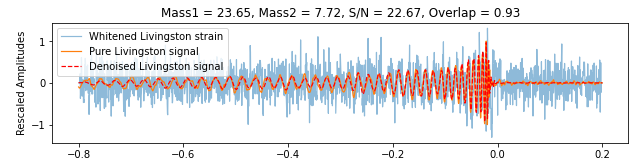

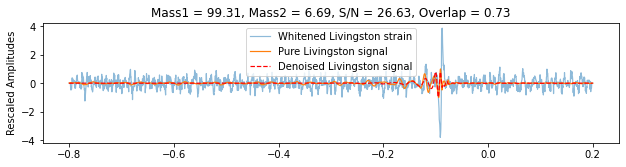

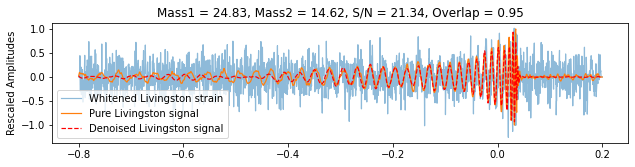

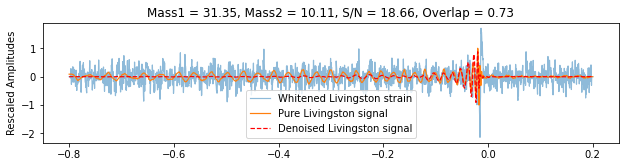

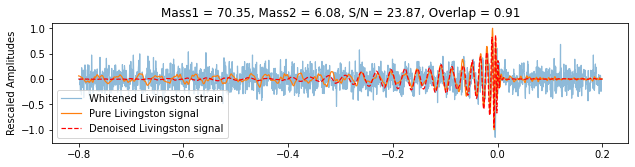

...

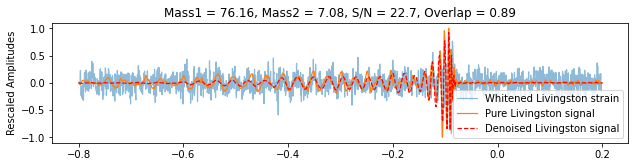

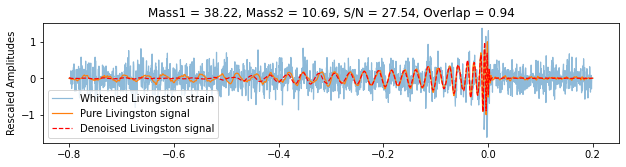

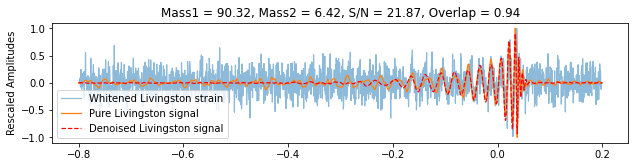

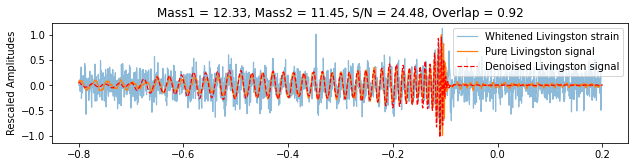

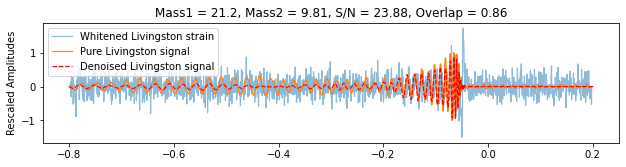

In [118]:
f1 = h5py.File('/fred/oz016/Chayan/GW-Denoiser/evaluation/results_IMBH_IMRPhenomXPHM_10_timesteps_O3b_signal_noise_SNR-all_max_mchirp_10.hdf', 'r')
f2 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_SNR-30to40_max_mchip_10.hdf", "r")

noise_index = range(100,125)
signal_index = range(25)
j = -1
   
for i in range(75,100):
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    
    strain = np.pad(f2['injection_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f2['injection_parameters']['mass1'][j]
    m2 = f2['injection_parameters']['mass2'][j]
    snr = f2['injection_parameters']['l1_snr'][j]*f2['injection_parameters']['scale_factor'][j]
    
    plot_reconstructed(decoded_signals[j].astype(np.float64), pure_signals, strain, m1, m2, snr)


# Test samples with no chirp mass constraint

# SNR - 8 to 9

In [61]:
f1 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_signal_noise_SNR-8to9.hdf", "r")
strain = f1['injection_samples']['l1_strain'][()]
noise = f1['noise_samples']['l1_strain'][()]

pure_signal = f1['injection_parameters']['l1_signal_whitened'][()]
pure_noise = f1['noise_parameters']['l1_signal_whitened'][()]


In [62]:
def _preprocess_data(data, num, samples):
    new_array = []
    for i in range(num):
        dataset = data[i]
        if((dataset.max() != 0.0) and (dataset.min() != 0.0)):
            maximum = np.max(dataset)
            minimum = np.abs(np.min(dataset))
            for j in range(samples):
                if(dataset[j] > 0):
                    dataset[j] = dataset[j]/maximum
                else:
                    dataset[j] = dataset[j]/minimum
        new_array.append(dataset)
    return new_array, maximum, minimum


In [63]:
strain, maximum, minimum = _preprocess_data(strain, 25, 2048)
strain = np.array(strain)
strain.shape

noise, maximum, minimum = _preprocess_data(noise, 25, 2048)
noise = np.array(noise)
noise.shape


(25, 2048)

In [64]:
# Split a univariate sequence into samples
#def split_sequence(sequence_noisy,sequence_pure,n_steps):
def split_sequence(sequence_noisy,n_steps):
    X = [] 
#    y = []
    for i in range(len(sequence_noisy)):
    # find the end of this pattern
        end_ix = i + n_steps
        # check if we are beyond the sequence
        if end_ix > len(sequence_noisy)-1:
            break
        # gather input and output parts of the pattern
        seq_x = sequence_noisy[i:end_ix] 
#        seq_y = sequence_pure[end_ix]
        X.append(seq_x)
#        y.append(seq_y)
#    return array(X), array(y)
    return np.array(X)
    
    
#def reshape_sequences(self, num, data_noisy, data_pure):
def reshape_sequences(num, data_noisy):
    n_steps = 10
    arr_noisy = []
#    arr_pure = []
        
    for i in range(num):
        X_noisy = data_noisy[i]
#        X_pure = data_pure[i]
        X_noisy = np.pad(X_noisy, (n_steps, n_steps), 'constant', constant_values=(0, 0))
#        X_pure = np.pad(X_pure, (n_steps, n_steps), 'constant', constant_values=(0, 0))
        # split into samples
#        X, y = self.split_sequence(X_noisy, X_pure, n_steps)
        X = split_sequence(X_noisy, n_steps)
        arr_noisy.append(X)
#        arr_pure.append(y)
    
    arr_noisy = np.asarray(arr_noisy)
#    arr_pure = np.asarray(arr_pure)
        
#    return arr_noisy, arr_pure
    return arr_noisy

X_test_strain = reshape_sequences(25, strain)
X_test_noise = reshape_sequences(25, noise)

X_test_pure_signal = reshape_sequences(25, pure_signal)
X_test_pure_noise = reshape_sequences(25, pure_noise)


In [65]:
# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
print('x_test_strain shape:', X_test_strain.shape)
X_test_strain = X_test_strain.astype("float32")

X_test_noise = X_test_noise[:,:,:,None]
print('x_test_noise shape:', X_test_noise.shape)
X_test_noise = X_test_noise.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
print('x_test_pure_signal shape:', X_test_pure_signal.shape)
X_test_pure_signal = X_test_pure_signal.astype("float32")

X_test_pure_noise = X_test_pure_noise[:,:,:,None]
print('x_test_pure_noise shape:', X_test_pure_noise.shape)
X_test_pure_noise = X_test_pure_noise.astype("float32")


x_test_strain shape: (25, 2058, 10, 1)
x_test_noise shape: (25, 2058, 10, 1)
x_test_pure_signal shape: (25, 2058, 10, 1)
x_test_pure_noise shape: (25, 2058, 10, 1)


In [66]:
class FractalTanimotoLoss(tf.keras.losses.Loss):
        def __init__(lr, base_lr=2e-3, depth=0, smooth=1e-6, **kwargs):
            depth = depth
            learning_rate = lr
            base_lr = base_lr
            smooth = smooth
            super().__init__(**kwargs)
    
        def inner_prod(self, y, x):
            prod = y*x
            prod = K.sum(prod, axis=1)
        
            return prod
    
        def tnmt_base(x, y, scale):

            tpl  = inner_prod(y,x)
            tpp  = inner_prod(y,y)
            tll  = inner_prod(x,x)


            num = tpl + self.smooth
            denum = 0.0
            result = 0.0
            for d in range(depth):
                a = 2.**d
                b = -(2.*a-1.)

                denum = denum + tf.math.reciprocal( a*(tpp+tll) + b *tpl + smooth)
                
            result =  num * denum * scale
            
            return  result*scale
        
        def call(y_true, y_pred):
            
            if(learning_rate < base_lr):
                depth = depth + 5
                
            depth = depth+1
            scale = 1./len(range(depth))
            
            l1 = K.mean(K.square(y_pred - y_true),axis=-1)
            result = tnmt_base(y_true, y_pred, scale)
        
            return  l1 - 0.01*result
        
        def get_config(self):
            base_config = super().get_config()
            return {**base_config, "depth": depth}   
    

In [67]:
#from keras.models import load_model
 
# load model
model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/trained_model_test_IMBH_HM_O3b_noise_mass_corrected.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})
# summarize model.
model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDistr  (None, 2058, 10, 32)     128       
 ibuted)                                                         
                                                                 
 time_distributed_1 (TimeDis  (None, 2058, 10, 32)     0         
 tributed)                                                       
                                                                 
 time_distributed_2 (TimeDis  (None, 2058, 5, 32)      0         
 tributed)                                                       
                                                                 
 time_distributed_3 (TimeDis  (None, 2058, 5, 16)      1552      
 tributed)                                                       
                                                                 
 time_distributed_4 (TimeDis  (None, 2058, 5, 16)      0

In [69]:
decoded_signals = model.predict(X_test_strain, batch_size=25)
decoded_signals_pure_noise = model.predict(X_test_noise, batch_size=25)


In [70]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries
import matplotlib.pyplot as plt

def plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr):
    
    time_buffer = 4
    length_signal = len(decoded_signals)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    
    X_test_pure_ts = TimeSeries(pure_signals.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signals.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

    if(X_test_pure_ts.max() != 0.0):
        m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
    else:
        m = 1
    
    fig = plt.figure(figsize=(10,5))

    time = np.linspace(-0.80, 0.20, length_signal)

    plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.4)

    signal_axes = fig.add_subplot(211)
#    signal_axes.set_ylim(-1.1, 1.1)
    signal_axes.set_title('Mass1 = {m1}, Mass2 = {m2}, S/N = {snr}, Overlap = {m}'.format(m1=np.round(m1,2), m2=np.round(m2,2), snr=np.round(snr,2), m=np.round(m,2)))
    signal_axes.plot(time,strain.squeeze()/0.05, linewidth=1.2, label ='Whitened Livingston strain', alpha=0.5)
    signal_axes.plot(time,pure_signals.squeeze(), linewidth=1.2, label ='Pure Livingston signal')
    signal_axes.plot(time,decoded_signals.squeeze(), linewidth=1.2, label ='Denoised Livingston signal', c='red', linestyle='dashed')
    signal_axes.set_ylabel('Rescaled Amplitudes')
    signal_axes.legend()

    plt.savefig('IMBH_test/IMRPhenomXPHM_O3b_signal+noise/SNR-8to9/Plot_m1-'+str(int(m1))+'_m2-'+str(int(m2))+'_snr-'+str(int(snr))+'.png', bbox_inches='tight', facecolor='w', transparent=False, dpi=200)


<ipython-input-70-867788214f43>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


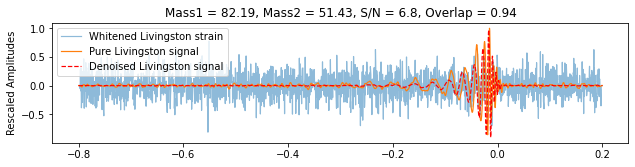

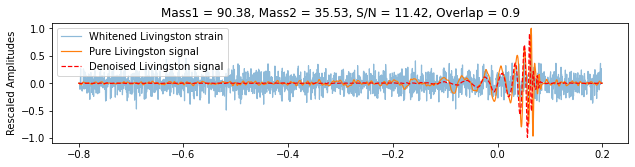

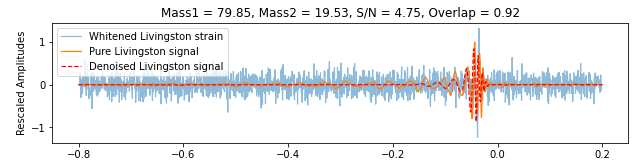

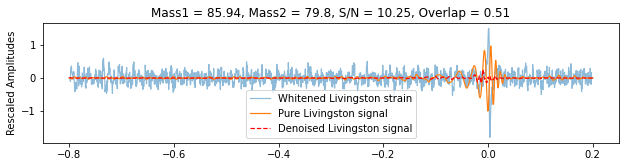

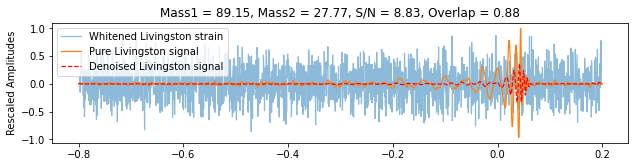

...

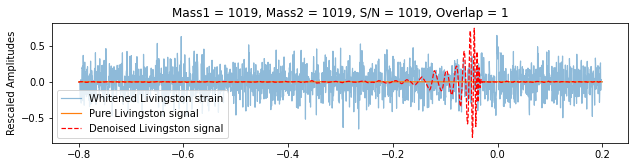

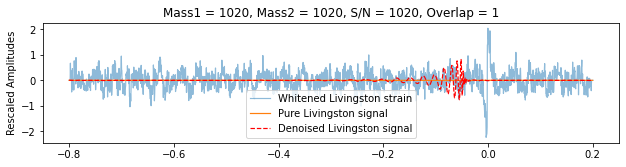

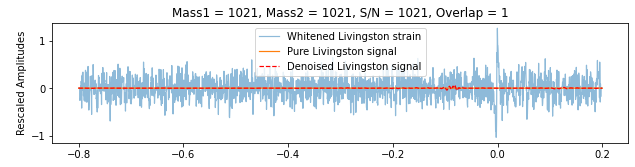

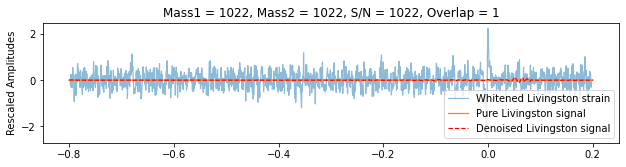

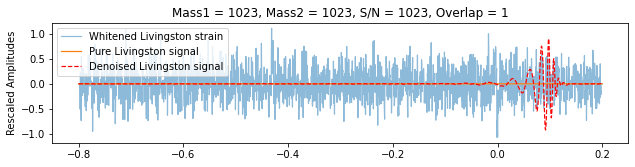

In [79]:
for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)


for i in range(25):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)
    

# SNR - 9 to 20

In [3]:
f1 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_signal_noise_SNR-9to20.hdf", "r")
strain = f1['injection_samples']['l1_strain'][()]
noise = f1['noise_samples']['l1_strain'][()]

pure_signal = f1['injection_parameters']['l1_signal_whitened'][()]
pure_noise = f1['noise_parameters']['l1_signal_whitened'][()]


In [4]:
def _preprocess_data(data, num, samples):
    new_array = []
    for i in range(num):
        dataset = data[i]
        if((dataset.max() != 0.0) and (dataset.min() != 0.0)):
            maximum = np.max(dataset)
            minimum = np.abs(np.min(dataset))
            for j in range(samples):
                if(dataset[j] > 0):
                    dataset[j] = dataset[j]/maximum
                else:
                    dataset[j] = dataset[j]/minimum
        new_array.append(dataset)
    return new_array, maximum, minimum


In [5]:
strain, maximum, minimum = _preprocess_data(strain, 25, 2048)
strain = np.array(strain)
strain.shape

noise, maximum, minimum = _preprocess_data(noise, 25, 2048)
noise = np.array(noise)
noise.shape


(25, 2048)

In [6]:
# Split a univariate sequence into samples
#def split_sequence(sequence_noisy,sequence_pure,n_steps):
def split_sequence(sequence_noisy,n_steps):
    X = [] 
#    y = []
    for i in range(len(sequence_noisy)):
    # find the end of this pattern
        end_ix = i + n_steps
        # check if we are beyond the sequence
        if end_ix > len(sequence_noisy)-1:
            break
        # gather input and output parts of the pattern
        seq_x = sequence_noisy[i:end_ix] 
#        seq_y = sequence_pure[end_ix]
        X.append(seq_x)
#        y.append(seq_y)
#    return array(X), array(y)
    return np.array(X)
    
    
#def reshape_sequences(self, num, data_noisy, data_pure):
def reshape_sequences(num, data_noisy):
    n_steps = 10
    arr_noisy = []
#    arr_pure = []
        
    for i in range(num):
        X_noisy = data_noisy[i]
#        X_pure = data_pure[i]
        X_noisy = np.pad(X_noisy, (n_steps, n_steps), 'constant', constant_values=(0, 0))
#        X_pure = np.pad(X_pure, (n_steps, n_steps), 'constant', constant_values=(0, 0))
        # split into samples
#        X, y = self.split_sequence(X_noisy, X_pure, n_steps)
        X = split_sequence(X_noisy, n_steps)
        arr_noisy.append(X)
#        arr_pure.append(y)
    
    arr_noisy = np.asarray(arr_noisy)
#    arr_pure = np.asarray(arr_pure)
        
#    return arr_noisy, arr_pure
    return arr_noisy

X_test_strain = reshape_sequences(25, strain)
X_test_noise = reshape_sequences(25, noise)

X_test_pure_signal = reshape_sequences(25, pure_signal)
X_test_pure_noise = reshape_sequences(25, pure_noise)


In [7]:
# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
print('x_test_strain shape:', X_test_strain.shape)
X_test_strain = X_test_strain.astype("float32")

X_test_noise = X_test_noise[:,:,:,None]
print('x_test_noise shape:', X_test_noise.shape)
X_test_noise = X_test_noise.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
print('x_test_pure_signal shape:', X_test_pure_signal.shape)
X_test_pure_signal = X_test_pure_signal.astype("float32")

X_test_pure_noise = X_test_pure_noise[:,:,:,None]
print('x_test_pure_noise shape:', X_test_pure_noise.shape)
X_test_pure_noise = X_test_pure_noise.astype("float32")


x_test_strain shape: (25, 2058, 10, 1)
x_test_noise shape: (25, 2058, 10, 1)
x_test_pure_signal shape: (25, 2058, 10, 1)
x_test_pure_noise shape: (25, 2058, 10, 1)


In [10]:
from __future__ import print_function
from matplotlib import pyplot as plt
plt.switch_backend('agg')
%matplotlib inline
import numpy as np
#import pandas as pd

from IPython.display import display, HTML
import tensorflow as tf
#import numpy as np
#import pandas as pd
#import random as ran
import h5py

class FractalTanimotoLoss(tf.keras.losses.Loss):
        def __init__(lr, base_lr=2e-3, depth=0, smooth=1e-6, **kwargs):
            depth = depth
            learning_rate = lr
            base_lr = base_lr
            smooth = smooth
            super().__init__(**kwargs)
    
        def inner_prod(self, y, x):
            prod = y*x
            prod = K.sum(prod, axis=1)
        
            return prod
    
        def tnmt_base(x, y, scale):

            tpl  = inner_prod(y,x)
            tpp  = inner_prod(y,y)
            tll  = inner_prod(x,x)


            num = tpl + self.smooth
            denum = 0.0
            result = 0.0
            for d in range(depth):
                a = 2.**d
                b = -(2.*a-1.)

                denum = denum + tf.math.reciprocal( a*(tpp+tll) + b *tpl + smooth)
                
            result =  num * denum * scale
            
            return  result*scale
        
        def call(y_true, y_pred):
            
            if(learning_rate < base_lr):
                depth = depth + 5
                
            depth = depth+1
            scale = 1./len(range(depth))
            
            l1 = K.mean(K.square(y_pred - y_true),axis=-1)
            result = tnmt_base(y_true, y_pred, scale)
        
            return  l1 - 0.01*result
        
        def get_config(self):
            base_config = super().get_config()
            return {**base_config, "depth": depth}   
    

In [11]:
#from keras.models import load_model
 
# load model
model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/trained_model_test_IMBH_HM_O3b_noise_mass_corrected.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})
# summarize model.
model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDistr  (None, 2058, 10, 32)     128       
 ibuted)                                                         
                                                                 
 time_distributed_1 (TimeDis  (None, 2058, 10, 32)     0         
 tributed)                                                       
                                                                 
 time_distributed_2 (TimeDis  (None, 2058, 5, 32)      0         
 tributed)                                                       
                                                                 
 time_distributed_3 (TimeDis  (None, 2058, 5, 16)      1552      
 tributed)                                                       
                                                                 
 time_distributed_4 (TimeDis  (None, 2058, 5, 16)      0

In [12]:
decoded_signals = model.predict(X_test_strain, batch_size=25)
decoded_signals_pure_noise = model.predict(X_test_noise, batch_size=25)


In [13]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries
import matplotlib.pyplot as plt

def plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr):
    
    time_buffer = 4
    length_signal = len(decoded_signals)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    
    X_test_pure_ts = TimeSeries(pure_signals.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signals.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

    if(X_test_pure_ts.max() != 0.0):
        m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
    else:
        m = 1
    
    fig = plt.figure(figsize=(10,5))

    time = np.linspace(-0.80, 0.20, length_signal)

    plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.4)

    signal_axes = fig.add_subplot(211)
#    signal_axes.set_ylim(-1.1, 1.1)
    signal_axes.set_title('Mass1 = {m1}, Mass2 = {m2}, S/N = {snr}, Overlap = {m}'.format(m1=np.round(m1,2), m2=np.round(m2,2), snr=np.round(snr,2), m=np.round(m,2)))
    signal_axes.plot(time,strain.squeeze()/0.05, linewidth=1.2, label ='Whitened Livingston strain', alpha=0.5)
    signal_axes.plot(time,pure_signals.squeeze(), linewidth=1.2, label ='Pure Livingston signal')
    signal_axes.plot(time,decoded_signals.squeeze(), linewidth=1.2, label ='Denoised Livingston signal', c='red', linestyle='dashed')
    signal_axes.set_ylabel('Rescaled Amplitudes')
    signal_axes.legend()

    plt.savefig('IMBH_test/IMRPhenomXPHM_O3b_signal+noise/SNR-9to20/Plot_m1-'+str(int(m1))+'_m2-'+str(int(m2))+'_snr-'+str(int(snr))+'.png', bbox_inches='tight', facecolor='w', transparent=False, dpi=200)


<ipython-input-13-413b901ad185>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


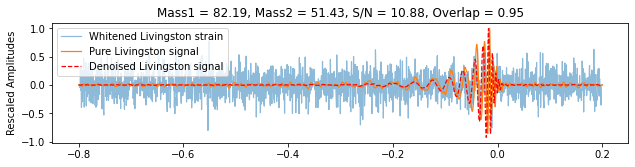

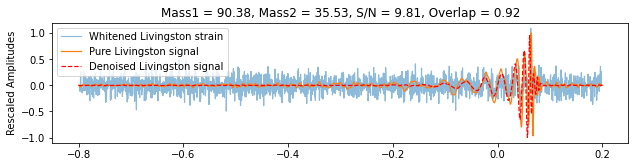

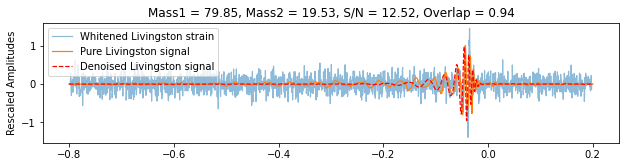

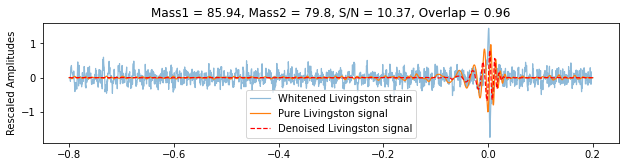

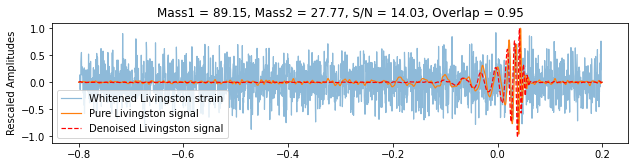

...

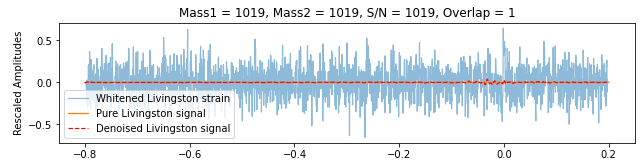

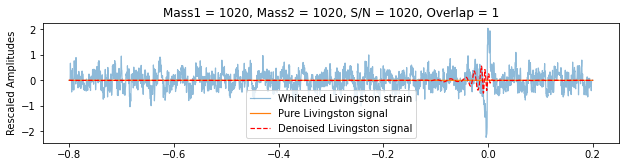

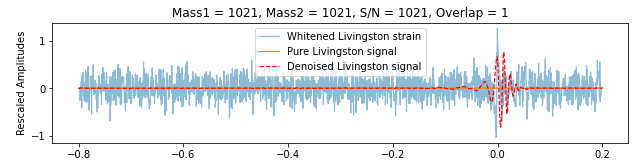

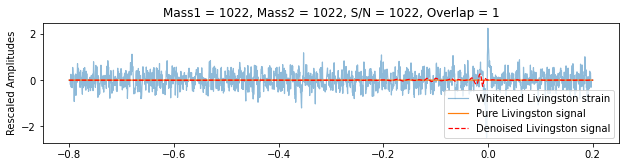

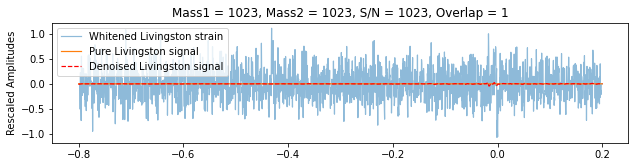

In [14]:
for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)


for i in range(25):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)
    

# SNR - 20 to 30

In [15]:
f1 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_signal_noise_SNR-20to30.hdf", "r")
strain = f1['injection_samples']['l1_strain'][()]
noise = f1['noise_samples']['l1_strain'][()]

pure_signal = f1['injection_parameters']['l1_signal_whitened'][()]
pure_noise = f1['noise_parameters']['l1_signal_whitened'][()]


In [16]:
def _preprocess_data(data, num, samples):
    new_array = []
    for i in range(num):
        dataset = data[i]
        if((dataset.max() != 0.0) and (dataset.min() != 0.0)):
            maximum = np.max(dataset)
            minimum = np.abs(np.min(dataset))
            for j in range(samples):
                if(dataset[j] > 0):
                    dataset[j] = dataset[j]/maximum
                else:
                    dataset[j] = dataset[j]/minimum
        new_array.append(dataset)
    return new_array, maximum, minimum


In [17]:
strain, maximum, minimum = _preprocess_data(strain, 25, 2048)
strain = np.array(strain)
strain.shape

noise, maximum, minimum = _preprocess_data(noise, 25, 2048)
noise = np.array(noise)
noise.shape


(25, 2048)

In [18]:
# Split a univariate sequence into samples
#def split_sequence(sequence_noisy,sequence_pure,n_steps):
def split_sequence(sequence_noisy,n_steps):
    X = [] 
#    y = []
    for i in range(len(sequence_noisy)):
    # find the end of this pattern
        end_ix = i + n_steps
        # check if we are beyond the sequence
        if end_ix > len(sequence_noisy)-1:
            break
        # gather input and output parts of the pattern
        seq_x = sequence_noisy[i:end_ix] 
#        seq_y = sequence_pure[end_ix]
        X.append(seq_x)
#        y.append(seq_y)
#    return array(X), array(y)
    return np.array(X)
    
    
#def reshape_sequences(self, num, data_noisy, data_pure):
def reshape_sequences(num, data_noisy):
    n_steps = 10
    arr_noisy = []
#    arr_pure = []
        
    for i in range(num):
        X_noisy = data_noisy[i]
#        X_pure = data_pure[i]
        X_noisy = np.pad(X_noisy, (n_steps, n_steps), 'constant', constant_values=(0, 0))
#        X_pure = np.pad(X_pure, (n_steps, n_steps), 'constant', constant_values=(0, 0))
        # split into samples
#        X, y = self.split_sequence(X_noisy, X_pure, n_steps)
        X = split_sequence(X_noisy, n_steps)
        arr_noisy.append(X)
#        arr_pure.append(y)
    
    arr_noisy = np.asarray(arr_noisy)
#    arr_pure = np.asarray(arr_pure)
        
#    return arr_noisy, arr_pure
    return arr_noisy

X_test_strain = reshape_sequences(25, strain)
X_test_noise = reshape_sequences(25, noise)

X_test_pure_signal = reshape_sequences(25, pure_signal)
X_test_pure_noise = reshape_sequences(25, pure_noise)


In [19]:
# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
print('x_test_strain shape:', X_test_strain.shape)
X_test_strain = X_test_strain.astype("float32")

X_test_noise = X_test_noise[:,:,:,None]
print('x_test_noise shape:', X_test_noise.shape)
X_test_noise = X_test_noise.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
print('x_test_pure_signal shape:', X_test_pure_signal.shape)
X_test_pure_signal = X_test_pure_signal.astype("float32")

X_test_pure_noise = X_test_pure_noise[:,:,:,None]
print('x_test_pure_noise shape:', X_test_pure_noise.shape)
X_test_pure_noise = X_test_pure_noise.astype("float32")


x_test_strain shape: (25, 2058, 10, 1)
x_test_noise shape: (25, 2058, 10, 1)
x_test_pure_signal shape: (25, 2058, 10, 1)
x_test_pure_noise shape: (25, 2058, 10, 1)


In [20]:
from __future__ import print_function
from matplotlib import pyplot as plt
plt.switch_backend('agg')
%matplotlib inline
import numpy as np
#import pandas as pd

from IPython.display import display, HTML
import tensorflow as tf
#import numpy as np
#import pandas as pd
#import random as ran
import h5py

class FractalTanimotoLoss(tf.keras.losses.Loss):
        def __init__(lr, base_lr=2e-3, depth=0, smooth=1e-6, **kwargs):
            depth = depth
            learning_rate = lr
            base_lr = base_lr
            smooth = smooth
            super().__init__(**kwargs)
    
        def inner_prod(self, y, x):
            prod = y*x
            prod = K.sum(prod, axis=1)
        
            return prod
    
        def tnmt_base(x, y, scale):

            tpl  = inner_prod(y,x)
            tpp  = inner_prod(y,y)
            tll  = inner_prod(x,x)


            num = tpl + self.smooth
            denum = 0.0
            result = 0.0
            for d in range(depth):
                a = 2.**d
                b = -(2.*a-1.)

                denum = denum + tf.math.reciprocal( a*(tpp+tll) + b *tpl + smooth)
                
            result =  num * denum * scale
            
            return  result*scale
        
        def call(y_true, y_pred):
            
            if(learning_rate < base_lr):
                depth = depth + 5
                
            depth = depth+1
            scale = 1./len(range(depth))
            
            l1 = K.mean(K.square(y_pred - y_true),axis=-1)
            result = tnmt_base(y_true, y_pred, scale)
        
            return  l1 - 0.01*result
        
        def get_config(self):
            base_config = super().get_config()
            return {**base_config, "depth": depth}   
    

In [22]:
#from keras.models import load_model
 
# load model
model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/trained_model_test_IMBH_HM_O3b_noise_mass_corrected.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})
# summarize model.
model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDistr  (None, 2058, 10, 32)     128       
 ibuted)                                                         
                                                                 
 time_distributed_1 (TimeDis  (None, 2058, 10, 32)     0         
 tributed)                                                       
                                                                 
 time_distributed_2 (TimeDis  (None, 2058, 5, 32)      0         
 tributed)                                                       
                                                                 
 time_distributed_3 (TimeDis  (None, 2058, 5, 16)      1552      
 tributed)                                                       
                                                                 
 time_distributed_4 (TimeDis  (None, 2058, 5, 16)      0

In [24]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries
import matplotlib.pyplot as plt

def plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr):
    
    time_buffer = 4
    length_signal = len(decoded_signals)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    
    X_test_pure_ts = TimeSeries(pure_signals.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signals.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

    if(X_test_pure_ts.max() != 0.0):
        m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
    else:
        m = 1
    
    fig = plt.figure(figsize=(10,5))

    time = np.linspace(-0.80, 0.20, length_signal)

    plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.4)

    signal_axes = fig.add_subplot(211)
#    signal_axes.set_ylim(-1.1, 1.1)
    signal_axes.set_title('Mass1 = {m1}, Mass2 = {m2}, S/N = {snr}, Overlap = {m}'.format(m1=np.round(m1,2), m2=np.round(m2,2), snr=np.round(snr,2), m=np.round(m,2)))
    signal_axes.plot(time,strain.squeeze()/0.05, linewidth=1.2, label ='Whitened Livingston strain', alpha=0.5)
    signal_axes.plot(time,pure_signals.squeeze(), linewidth=1.2, label ='Pure Livingston signal')
    signal_axes.plot(time,decoded_signals.squeeze(), linewidth=1.2, label ='Denoised Livingston signal', c='red', linestyle='dashed')
    signal_axes.set_ylabel('Rescaled Amplitudes')
    signal_axes.legend()

    plt.savefig('IMBH_test/IMRPhenomXPHM_O3b_signal+noise/SNR-20to30/Plot_m1-'+str(int(m1))+'_m2-'+str(int(m2))+'_snr-'+str(int(snr))+'.png', bbox_inches='tight', facecolor='w', transparent=False, dpi=200)


<ipython-input-24-d6c89d352cc2>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


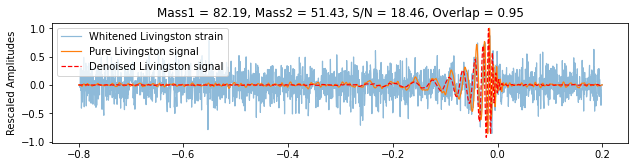

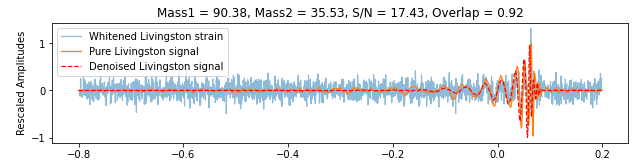

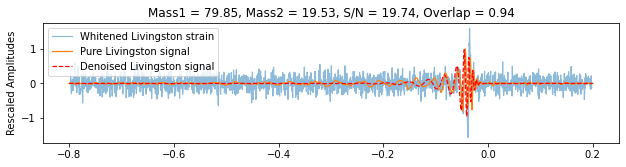

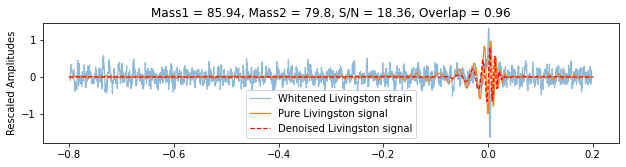

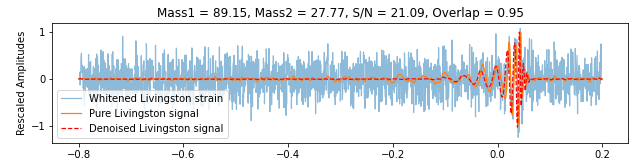

...

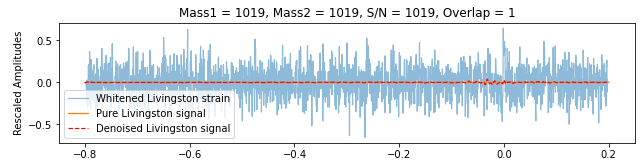

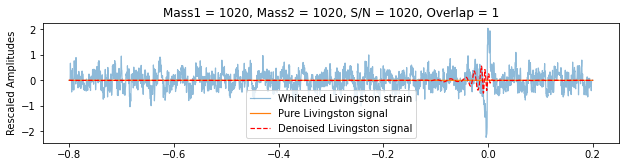

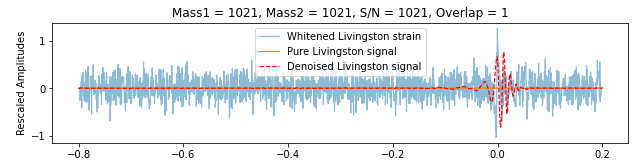

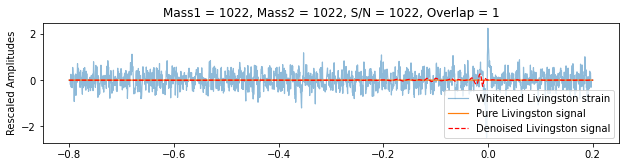

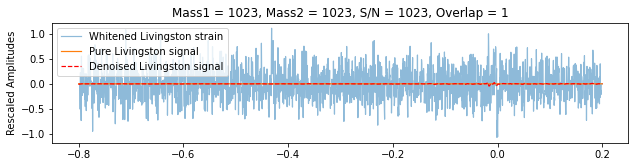

In [25]:
for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)


for i in range(25):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)
    

# SNR - 30 to 40

In [26]:
f1 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_signal_noise_SNR-30to40.hdf", "r")
strain = f1['injection_samples']['l1_strain'][()]
noise = f1['noise_samples']['l1_strain'][()]

pure_signal = f1['injection_parameters']['l1_signal_whitened'][()]
pure_noise = f1['noise_parameters']['l1_signal_whitened'][()]


In [27]:
def _preprocess_data(data, num, samples):
    new_array = []
    for i in range(num):
        dataset = data[i]
        if((dataset.max() != 0.0) and (dataset.min() != 0.0)):
            maximum = np.max(dataset)
            minimum = np.abs(np.min(dataset))
            for j in range(samples):
                if(dataset[j] > 0):
                    dataset[j] = dataset[j]/maximum
                else:
                    dataset[j] = dataset[j]/minimum
        new_array.append(dataset)
    return new_array, maximum, minimum


In [28]:
strain, maximum, minimum = _preprocess_data(strain, 25, 2048)
strain = np.array(strain)
strain.shape

noise, maximum, minimum = _preprocess_data(noise, 25, 2048)
noise = np.array(noise)
noise.shape


(25, 2048)

In [29]:
# Split a univariate sequence into samples
#def split_sequence(sequence_noisy,sequence_pure,n_steps):
def split_sequence(sequence_noisy,n_steps):
    X = [] 
#    y = []
    for i in range(len(sequence_noisy)):
    # find the end of this pattern
        end_ix = i + n_steps
        # check if we are beyond the sequence
        if end_ix > len(sequence_noisy)-1:
            break
        # gather input and output parts of the pattern
        seq_x = sequence_noisy[i:end_ix] 
#        seq_y = sequence_pure[end_ix]
        X.append(seq_x)
#        y.append(seq_y)
#    return array(X), array(y)
    return np.array(X)
    
    
#def reshape_sequences(self, num, data_noisy, data_pure):
def reshape_sequences(num, data_noisy):
    n_steps = 10
    arr_noisy = []
#    arr_pure = []
        
    for i in range(num):
        X_noisy = data_noisy[i]
#        X_pure = data_pure[i]
        X_noisy = np.pad(X_noisy, (n_steps, n_steps), 'constant', constant_values=(0, 0))
#        X_pure = np.pad(X_pure, (n_steps, n_steps), 'constant', constant_values=(0, 0))
        # split into samples
#        X, y = self.split_sequence(X_noisy, X_pure, n_steps)
        X = split_sequence(X_noisy, n_steps)
        arr_noisy.append(X)
#        arr_pure.append(y)
    
    arr_noisy = np.asarray(arr_noisy)
#    arr_pure = np.asarray(arr_pure)
        
#    return arr_noisy, arr_pure
    return arr_noisy

X_test_strain = reshape_sequences(25, strain)
X_test_noise = reshape_sequences(25, noise)

X_test_pure_signal = reshape_sequences(25, pure_signal)
X_test_pure_noise = reshape_sequences(25, pure_noise)


In [30]:
# Reshape arrays to fit into Keras model
X_test_strain = X_test_strain[:,:,:,None]
print('x_test_strain shape:', X_test_strain.shape)
X_test_strain = X_test_strain.astype("float32")

X_test_noise = X_test_noise[:,:,:,None]
print('x_test_noise shape:', X_test_noise.shape)
X_test_noise = X_test_noise.astype("float32")

X_test_pure_signal = X_test_pure_signal[:,:,:,None]
print('x_test_pure_signal shape:', X_test_pure_signal.shape)
X_test_pure_signal = X_test_pure_signal.astype("float32")

X_test_pure_noise = X_test_pure_noise[:,:,:,None]
print('x_test_pure_noise shape:', X_test_pure_noise.shape)
X_test_pure_noise = X_test_pure_noise.astype("float32")


x_test_strain shape: (25, 2058, 10, 1)
x_test_noise shape: (25, 2058, 10, 1)
x_test_pure_signal shape: (25, 2058, 10, 1)
x_test_pure_noise shape: (25, 2058, 10, 1)


In [31]:
from __future__ import print_function
from matplotlib import pyplot as plt
plt.switch_backend('agg')
%matplotlib inline
import numpy as np
#import pandas as pd

from IPython.display import display, HTML
import tensorflow as tf
#import numpy as np
#import pandas as pd
#import random as ran
import h5py

class FractalTanimotoLoss(tf.keras.losses.Loss):
        def __init__(lr, base_lr=2e-3, depth=0, smooth=1e-6, **kwargs):
            depth = depth
            learning_rate = lr
            base_lr = base_lr
            smooth = smooth
            super().__init__(**kwargs)
    
        def inner_prod(self, y, x):
            prod = y*x
            prod = K.sum(prod, axis=1)
        
            return prod
    
        def tnmt_base(x, y, scale):

            tpl  = inner_prod(y,x)
            tpp  = inner_prod(y,y)
            tll  = inner_prod(x,x)


            num = tpl + self.smooth
            denum = 0.0
            result = 0.0
            for d in range(depth):
                a = 2.**d
                b = -(2.*a-1.)

                denum = denum + tf.math.reciprocal( a*(tpp+tll) + b *tpl + smooth)
                
            result =  num * denum * scale
            
            return  result*scale
        
        def call(y_true, y_pred):
            
            if(learning_rate < base_lr):
                depth = depth + 5
                
            depth = depth+1
            scale = 1./len(range(depth))
            
            l1 = K.mean(K.square(y_pred - y_true),axis=-1)
            result = tnmt_base(y_true, y_pred, scale)
        
            return  l1 - 0.01*result
        
        def get_config(self):
            base_config = super().get_config()
            return {**base_config, "depth": depth}   
    

In [32]:
#from keras.models import load_model
 
# load model
model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/trained_model_test_IMBH_HM_O3b_noise_mass_corrected.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})
# summarize model.
model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDistr  (None, 2058, 10, 32)     128       
 ibuted)                                                         
                                                                 
 time_distributed_1 (TimeDis  (None, 2058, 10, 32)     0         
 tributed)                                                       
                                                                 
 time_distributed_2 (TimeDis  (None, 2058, 5, 32)      0         
 tributed)                                                       
                                                                 
 time_distributed_3 (TimeDis  (None, 2058, 5, 16)      1552      
 tributed)                                                       
                                                                 
 time_distributed_4 (TimeDis  (None, 2058, 5, 16)      0

In [33]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries
import matplotlib.pyplot as plt

def plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr):
    
    time_buffer = 4
    length_signal = len(decoded_signals)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    
    X_test_pure_ts = TimeSeries(pure_signals.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signals.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

    if(X_test_pure_ts.max() != 0.0):
        m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
    else:
        m = 1
    
    fig = plt.figure(figsize=(10,5))

    time = np.linspace(-0.80, 0.20, length_signal)

    plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.4)

    signal_axes = fig.add_subplot(211)
#    signal_axes.set_ylim(-1.1, 1.1)
    signal_axes.set_title('Mass1 = {m1}, Mass2 = {m2}, S/N = {snr}, Overlap = {m}'.format(m1=np.round(m1,2), m2=np.round(m2,2), snr=np.round(snr,2), m=np.round(m,2)))
    signal_axes.plot(time,strain.squeeze()/0.05, linewidth=1.2, label ='Whitened Livingston strain', alpha=0.5)
    signal_axes.plot(time,pure_signals.squeeze(), linewidth=1.2, label ='Pure Livingston signal')
    signal_axes.plot(time,decoded_signals.squeeze(), linewidth=1.2, label ='Denoised Livingston signal', c='red', linestyle='dashed')
    signal_axes.set_ylabel('Rescaled Amplitudes')
    signal_axes.legend()

    plt.savefig('IMBH_test/IMRPhenomXPHM_O3b_signal+noise/SNR-30to40/Plot_m1-'+str(int(m1))+'_m2-'+str(int(m2))+'_snr-'+str(int(snr))+'.png', bbox_inches='tight', facecolor='w', transparent=False, dpi=200)


<ipython-input-33-4dc024d7b7b3>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


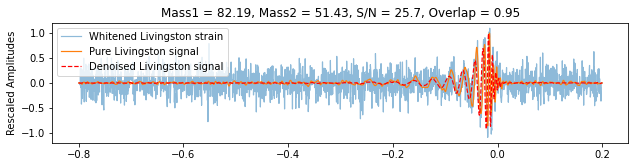

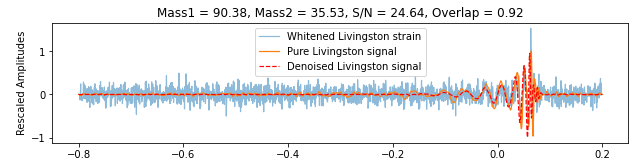

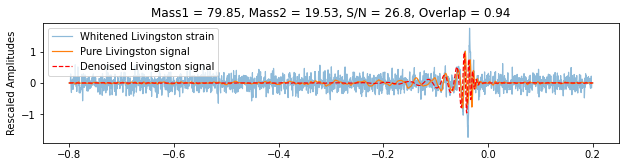

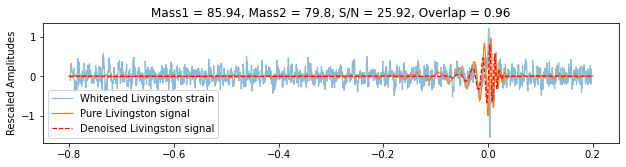

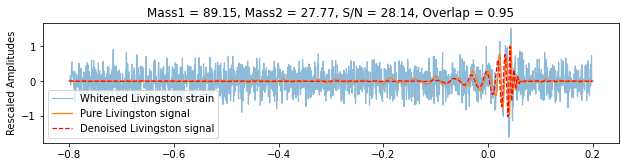

...

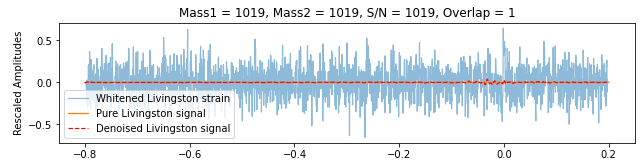

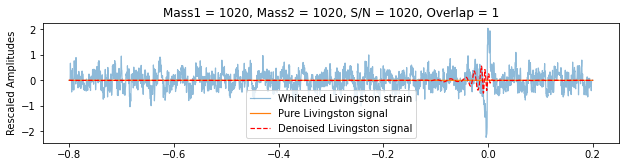

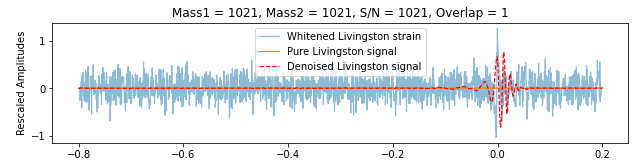

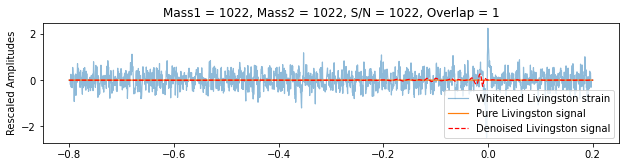

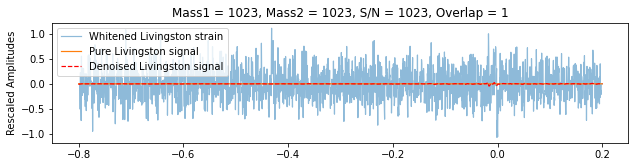

In [34]:
for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))   
    strain = np.pad(f1['injection_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][i]*f1['injection_parameters']['scale_factor'][i]
    
    plot_reconstructed(decoded_signals[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)


for i in range(25):
    
    pure_signals = np.pad(f1['noise_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))     
    strain = np.pad(f1['noise_samples']['l1_strain'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals_pure_noise[i].squeeze().astype(np.float64), pure_signals, strain, m1, m2, snr)
    

# New model with dilated convolutions, 25 timesteps and MAE loss 

In [3]:
def Overlap_calc(hp,sp,psd):
    f_low = 18
    m, i = match(hp, sp, psd=psd, low_frequency_cutoff=f_low)
    o = overlap(hp, sp, psd=psd, low_frequency_cutoff=f_low)
    return m


In [9]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries
import matplotlib.pyplot as plt

def plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr):
    
    time_buffer = 4
    length_signal = len(decoded_signals)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    
    X_test_pure_ts = TimeSeries(pure_signals.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signals.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

    if(X_test_pure_ts.max() != 0.0):
        m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
    else:
        m = 1
    
    fig = plt.figure(figsize=(10,5))

    time = np.linspace(-0.80, 0.20, length_signal)

    plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.4)

    signal_axes = fig.add_subplot(211)
#    signal_axes.set_ylim(-1.1, 1.1)
    signal_axes.set_title('Mass1 = {m1}, Mass2 = {m2}, S/N = {snr}, Overlap = {m}'.format(m1=np.round(m1,2), m2=np.round(m2,2), snr=np.round(snr,2), m=np.round(m,2)))
    signal_axes.plot(time,strain.squeeze()/0.05, linewidth=1.2, label ='Whitened Livingston strain', alpha=0.5)
    signal_axes.plot(time,pure_signals.squeeze(), linewidth=1.2, label ='Pure Livingston signal')
    signal_axes.plot(time,decoded_signals.squeeze(), linewidth=1.2, label ='Denoised Livingston signal', c='red', linestyle='dashed')
    signal_axes.set_ylabel('Rescaled Amplitudes')
    signal_axes.legend()

    plt.savefig('IMBH_test/IMRPhenomXPHM_O3b_signal+noise_25_timesteps_dilated_conv_MAE/Mchirp_10to20/SNR-10to20/Plot_m1-'+str(int(m1))+'_m2-'+str(int(m2))+'_snr-'+str(int(snr))+'.png', bbox_inches='tight', facecolor='w', transparent=False, dpi=200)


# SNR - 8 to 10

<ipython-input-4-74c8b8041823>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


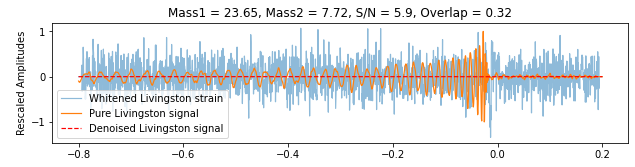

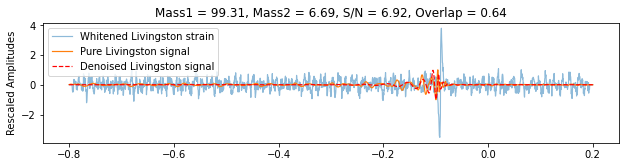

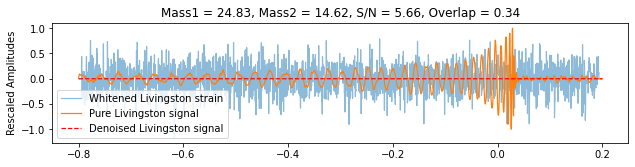

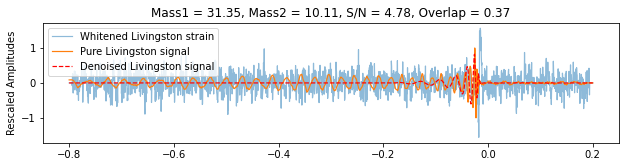

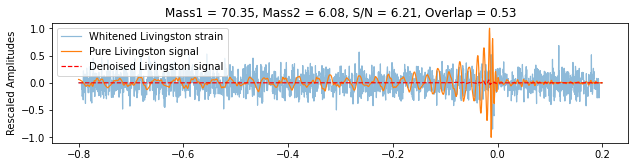

...

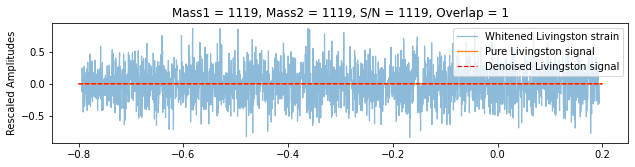

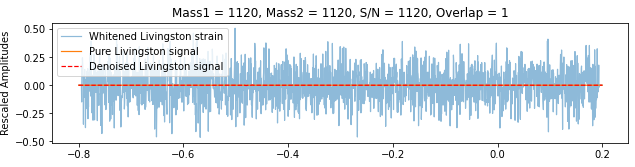

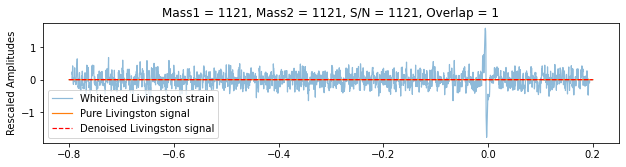

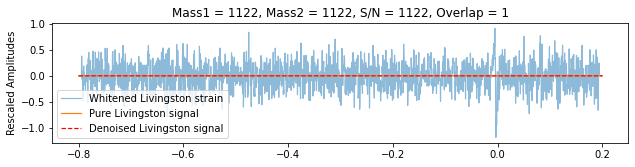

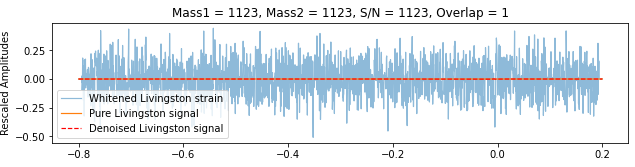

In [8]:
f1 = h5py.File('/fred/oz016/Chayan/GW-Denoiser/evaluation/results_IMRPhenomXPHM_25_timesteps_O3b_signal_noise_SNR-8to30_mchirp_10-20_dilated_CNN.hdf', 'r')
f2 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_test_IMRPhenomXPHM_SNR-8to10_max_mchip_10.hdf", "r")

noise_index = range(100,125)
signal_index = range(25)
j = -1
   
for i in range(25):
    decoded_signals = f1['denoised_signals'][i].astype(np.float64)
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    
    strain = np.pad(f2['injection_samples']['l1_strain'][j].astype(np.float64), (12,13), constant_values=(0,0))
    
    m1 = f2['injection_parameters']['mass1'][i]
    m2 = f2['injection_parameters']['mass2'][i]
    snr = f2['injection_parameters']['l1_snr'][j]*f2['injection_parameters']['scale_factor'][j]
    
    plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr)

j = -1

for i in range(100,125):
    
    decoded_signals = f1['denoised_signals'][i].astype(np.float64)
    pure_signals = f1['pure_signals'][i].astype(np.float64)
    
    j+=1
    strain = np.pad(f2['noise_samples']['l1_strain'][j].astype(np.float64), (12,13), constant_values=(0,0))
    
    m1 = 999 + i
    m2 = 999 + i
    snr = 999 + i
        
    plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr)
    

In [2]:
f1 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_train_IMRPhenomXPHM_signal_noise_SNR-8to40_mchirp_all.hdf", "r")
strain = f1['injection_samples']['l1_strain'][()]
signal = f1['injection_parameters']['l1_signal_whitened'][()]


In [129]:
def _preprocess_data(data, num, samples):
    new_array = []
    for i in range(num):
        dataset = data[i]
        if((dataset.max() != 0.0) and (dataset.min() != 0.0)):
            maximum = np.max(dataset)
            minimum = np.abs(np.min(dataset))
            for j in range(samples):
                if(dataset[j] > 0):
                    dataset[j] = dataset[j]/maximum
                else:
                    dataset[j] = dataset[j]/minimum
        new_array.append(dataset)
    return new_array, maximum, minimum


In [130]:
strain, maximum, minimum = _preprocess_data(strain, 25, 2048)
strain = np.array(strain)
strain.shape

signal, maximum, minimum = _preprocess_data(signal, 25, 2048)
signal = np.array(signal)
signal.shape


(25, 2048)

In [131]:
# Split a univariate sequence into samples
#def split_sequence(sequence_noisy,sequence_pure,n_steps):
def split_sequence(sequence_noisy,n_steps):
    X = [] 
#    y = []
    for i in range(len(sequence_noisy)):
    # find the end of this pattern
        end_ix = i + n_steps
        # check if we are beyond the sequence
        if end_ix > len(sequence_noisy)-1:
            break
        # gather input and output parts of the pattern
        seq_x = sequence_noisy[i:end_ix] 
#        seq_y = sequence_pure[end_ix]
        X.append(seq_x)
#        y.append(seq_y)
#    return array(X), array(y)
    return np.array(X)
    
    
#def reshape_sequences(self, num, data_noisy, data_pure):
def reshape_sequences(num, data_noisy):
    n_steps = 10
    arr_noisy = []
#    arr_pure = []
        
    for i in range(num):
        X_noisy = data_noisy[i]
#        X_pure = data_pure[i]
        X_noisy = np.pad(X_noisy, (n_steps, n_steps), 'constant', constant_values=(0, 0))
#        X_pure = np.pad(X_pure, (n_steps, n_steps), 'constant', constant_values=(0, 0))
        # split into samples
#        X, y = self.split_sequence(X_noisy, X_pure, n_steps)
        X = split_sequence(X_noisy, n_steps)
        arr_noisy.append(X)
#        arr_pure.append(y)
    
    arr_noisy = np.asarray(arr_noisy)
#    arr_pure = np.asarray(arr_pure)
        
#    return arr_noisy, arr_pure
    return arr_noisy

X_test_noisy = reshape_sequences(25, strain)
X_test_pure = reshape_sequences(25, signal)


In [132]:
# Reshape arrays to fit into Keras model
X_test_noisy = X_test_noisy[:,:,:,None]
        
print('x_test_noisy shape:', X_test_noisy.shape)

X_test_noisy = X_test_noisy.astype("float32")

X_test_pure = X_test_pure[:,:,:,None]
        
print('x_test_pure shape:', X_test_pure.shape)

X_test_pure = X_test_pure.astype("float32")


x_test_noisy shape: (25, 2058, 10, 1)
x_test_pure shape: (25, 2058, 10, 1)


In [133]:
class FractalTanimotoLoss(tf.keras.losses.Loss):
        def __init__(lr, base_lr=2e-3, depth=0, smooth=1e-6, **kwargs):
            depth = depth
            learning_rate = lr
            base_lr = base_lr
            smooth = smooth
            super().__init__(**kwargs)
    
        def inner_prod(self, y, x):
            prod = y*x
            prod = K.sum(prod, axis=1)
        
            return prod
    
        def tnmt_base(x, y, scale):

            tpl  = inner_prod(y,x)
            tpp  = inner_prod(y,y)
            tll  = inner_prod(x,x)


            num = tpl + self.smooth
            denum = 0.0
            result = 0.0
            for d in range(depth):
                a = 2.**d
                b = -(2.*a-1.)

                denum = denum + tf.math.reciprocal( a*(tpp+tll) + b *tpl + smooth)
                
            result =  num * denum * scale
            
            return  result*scale
        
        def call(y_true, y_pred):
            
            if(learning_rate < base_lr):
                depth = depth + 5
                
            depth = depth+1
            scale = 1./len(range(depth))
            
            l1 = K.mean(K.square(y_pred - y_true),axis=-1)
            result = tnmt_base(y_true, y_pred, scale)
        
            return  l1 - 0.01*result
        
        def get_config(self):
            base_config = super().get_config()
            return {**base_config, "depth": depth}   
    

In [134]:
#from keras.models import load_model

import tensorflow as tf
    
# load model
model = tf.keras.models.load_model('/fred/oz016/Chayan/GW-Denoiser/model/trained_model_test_IMBH_HM_O3b_noise_mass_corrected.h5', custom_objects={'FractalTanimotoLoss': FractalTanimotoLoss})
# summarize model.
model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDistr  (None, 2058, 10, 32)     128       
 ibuted)                                                         
                                                                 
 time_distributed_1 (TimeDis  (None, 2058, 10, 32)     0         
 tributed)                                                       
                                                                 
 time_distributed_2 (TimeDis  (None, 2058, 5, 32)      0         
 tributed)                                                       
                                                                 
 time_distributed_3 (TimeDis  (None, 2058, 5, 16)      1552      
 tributed)                                                       
                                                                 
 time_distributed_4 (TimeDis  (None, 2058, 5, 16)      0

In [135]:
decoded_signals = model.predict(X_test_noisy, batch_size=25)


In [136]:
from pycbc.filter import match, overlap
from pycbc.psd import aLIGOZeroDetHighPower
from pycbc.types.timeseries import TimeSeries
import matplotlib.pyplot as plt

def plot_reconstructed(decoded_signals, pure_signals, strain, m1, m2, snr):
    
    time_buffer = 4
    length_signal = len(decoded_signals)

    f_low = 18
    sample_rate = 2048

    # Length of corresponding time series and frequency series
    tlen = sample_rate * time_buffer
    flen = tlen // 2 + 1

    delta_f = 1.0 / time_buffer
    psd = aLIGOZeroDetHighPower(flen, delta_f, f_low)
    
    X_test_pure_ts = TimeSeries(pure_signals.squeeze(), delta_t = 1.0/2048)
    decoded_signals_ts = TimeSeries(decoded_signals.squeeze(), delta_t = 1.0/2048)

    X_test_pure_ts.resize(tlen)
    decoded_signals_ts.resize(tlen)

    if(X_test_pure_ts.max() != 0.0):
        m = Overlap_calc(X_test_pure_ts,decoded_signals_ts,psd)
    else:
        m = 1
    
    fig = plt.figure(figsize=(10,5))

    time = np.linspace(-0.80, 0.20, length_signal)

    plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.4)

    signal_axes = fig.add_subplot(211)
#    signal_axes.set_ylim(-1.1, 1.1)
    signal_axes.set_title('Mass1 = {m1}, Mass2 = {m2}, S/N = {snr}, Overlap = {m}'.format(m1=np.round(m1,2), m2=np.round(m2,2), snr=np.round(snr,2), m=np.round(m,2)))
    signal_axes.plot(time,strain.squeeze()/0.05, linewidth=1.2, label ='Whitened Livingston strain', alpha=0.5)
    signal_axes.plot(time,pure_signals.squeeze(), linewidth=1.2, label ='Pure Livingston signal')
    signal_axes.plot(time,decoded_signals.squeeze(), linewidth=1.2, label ='Denoised Livingston signal', c='red', linestyle='dashed')
    signal_axes.set_ylabel('Rescaled Amplitudes')
    signal_axes.legend()

#    plt.savefig('IMBH_test/IMRPhenomXPHM_O3b_signal+noise/Chirp_mass_test/Mchirp_10to20/SNR-30to40/Weighted_loss_Plot_m1-'+str(int(m1))+'_m2-'+str(int(m2))+'_snr-'+str(int(snr))+'.png', bbox_inches='tight', facecolor='w', transparent=False, dpi=200)


# Old model trained with Mchirp > 10

In [ ]:
noise_index = range(100,125)
signal_index = range(25)
j = -1
   
for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (5,5), constant_values=(0,0))
    
    j+=1
    
    strain = np.pad(f1['injection_samples']['l1_strain'][j].astype(np.float64), (5,5), constant_values=(0,0))
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][j]*f2['injection_parameters']['scale_factor'][j]
    
    plot_reconstructed(decoded_signals[i].astype(np.float64), pure_signals, strain, m1, m2, snr)


# New model with dilated CNN, 25 timesteps, MAE loss, trained with Mchirp > 10

<ipython-input-126-33628dabd372>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10,5))


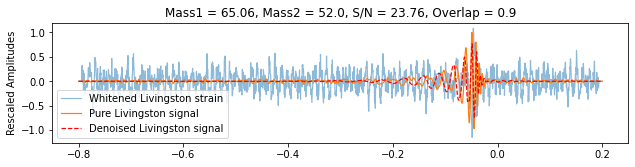

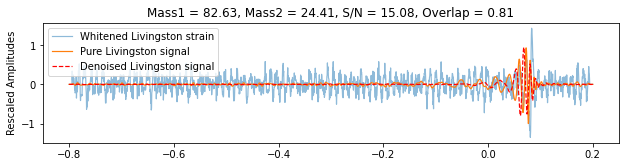

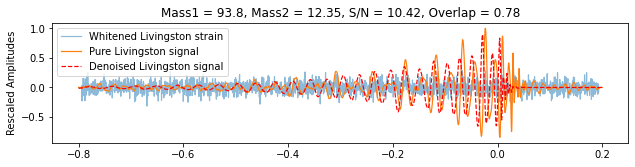

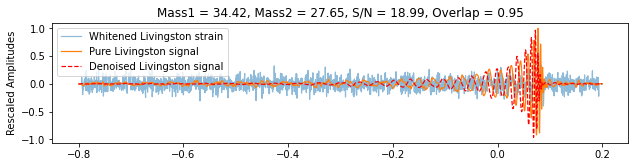

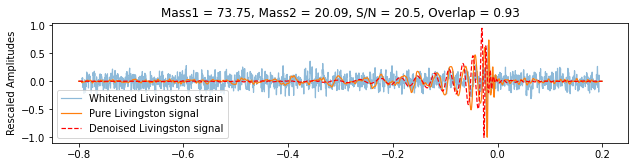

...

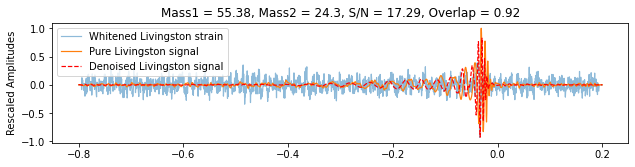

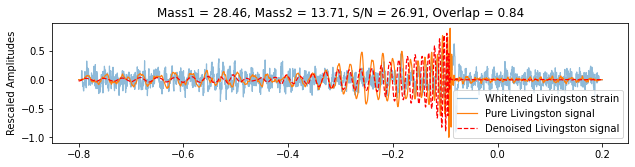

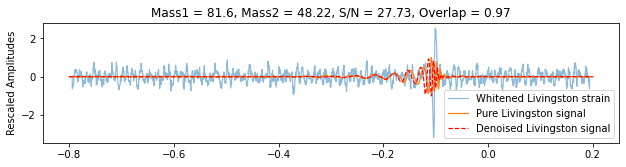

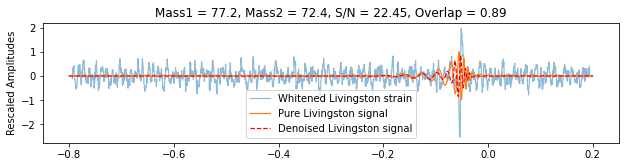

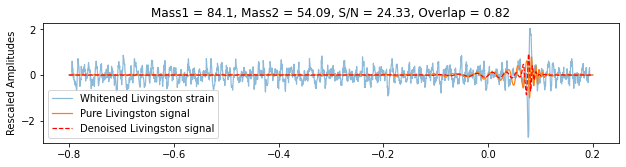

In [127]:
noise_index = range(100,125)
signal_index = range(25)
j = -1
   
for i in range(25):
    pure_signals = np.pad(f1['injection_parameters']['l1_signal_whitened'][i].astype(np.float64), (12,13), constant_values=(0,0))
    
    j+=1
    
    strain = np.pad(f1['injection_samples']['l1_strain'][j].astype(np.float64), (12,), constant_values=(0,0))
    
    m1 = f1['injection_parameters']['mass1'][i]
    m2 = f1['injection_parameters']['mass2'][i]
    snr = f1['injection_parameters']['l1_snr'][j]*f2['injection_parameters']['scale_factor'][j]
    
    plot_reconstructed(decoded_signals[i].astype(np.float64), pure_signals, strain, m1, m2, snr)


In [2]:
import h5py

f1 = h5py.File("/fred/oz016/Chayan/BBH_sample_files/O3b_IMBH_train_IMRPhenomXPHM_signal_noise_SNR-8to30.hdf", "r")


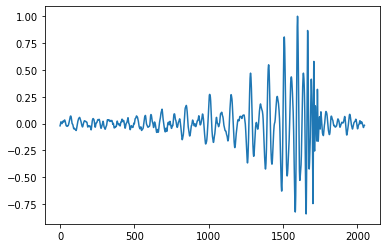

In [96]:
plt.plot(f1['injection_parameters']['l1_signal_whitened'][2])

In [ ]:
len(f1['injection_samples']['l1_strain'][()])